# Fake Text Detection with Steering Vectors:

Это третья часть исследования с моделью falcon3-7B-Base.
- Фейковые и реальные тексты для построения стиринг векторов взяты из COLING (https://huggingface.co/datasets/Jinyan1/COLING_2025_MGT_en). 
- Для активаци и стиринг вектороф были созданы графики магнитуды, косинусного подобия от слоя а слою, heat-Map усредненного стиринг вектора, а тaкже T-SNE, PCA и UMAP каждого слоя относительно меток и график дисперсии классов по слоям.
- Для задачи детектирования фейковых текстов был изначально взят домен текстов с reddit - тренировачное и тестовое множества. Из активации стоев и стиринг ветороа былы посчитаны проекции фейковости и обучены три классификатора: логистическая регрессия, random forest и SVM. 
- Для каждого из классификаторов были постоены графики и посчитаны основные метрики. Классификаторы были обучены на каждом слое, чтобы понять какая активация какого слоя лучше всего подходит для детекции фейковых текстов.
- Пункт выше также был проделан для тренировки классификаторов на стиринг векторах одного домена (в моем случае reddit) и теста на текстах другого домена (в моем случае домены financial, medical). Идея переноса на именно эти домены возникла по причине специфичности этих текстов: фининсовые и медицинские тексты имеют определенную структуру и термины, которых необходимо придерживаться - как человеку, так и машине. Это привносит определенную сложность в детектирование таких текстов, т.к. кретивность в этих текстах неуместна и человеку приходится придерживаться определенного стиля и "стандарта". 

### Загрузка необходимых библиотек: при первом запуске необходимо создать venv (virtual environment) и выбрать его для последующей работы. В него необходимо установить библиотеки: это можно сделать либо через pip следующих сточек команд, либо через терминал из requirements.txt.

In [ ]:
#%pip install -U datasets steering-vectors accelerate bitsandbytes
# #%pip install umap-learn transformers

In [1]:
import torch
print(torch.version.cuda)
print(torch.cuda.is_available())
print(torch.cuda.device_count())
print(torch.cuda.get_device_name(0) if torch.cuda.is_available() else "No CUDA device")
import steering_vectors
from transformers import AutoTokenizer, AutoModelForCausalLM
import datasets
import seaborn as sns
import numpy as np
import pandas as pd
from matplotlib import pyplot as plt
from sklearn.metrics import roc_auc_score
from copy import copy

import math
from collections.abc import Iterable
from dataclasses import dataclass

from tqdm import tqdm
from transformers import PreTrainedModel as Model
from transformers import PreTrainedTokenizerBase as Tokenizer
from typing import Dict, List, Tuple, Optional, Any
import pickle
import os
import logging

from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
import umap

from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, classification_report
from sklearn.preprocessing import StandardScaler
from scipy.stats import pearsonr
from pprint import pprint
import joblib
import shutil
import sys
from datasets import Dataset, concatenate_datasets
from scipy.spatial.distance import pdist
import warnings

warnings.filterwarnings("ignore", category=FutureWarning)
warnings.filterwarnings("ignore", category=UserWarning)

12.1
True
1
NVIDIA GeForce RTX 4090


In [3]:
import huggingface_hub

huggingface_hub.notebook_login()

In [4]:
device = torch.device(str("cuda:0") if torch.cuda.is_available() else "cpu")
device

device(type='cuda', index=0)

### Для вычисления стиринг векторов, их проекций и их сравнения, а также для создания визуализации я написала специальные функции, но они получились большими. Поэтому их можно найти в отбельном модуле:

In [4]:
sys.path.append('..') # Путь к папке compute_steering_vectors
from compute_steering_vectors import calculate_steering_vector

### Для создания визуализаций я также написала функцию, которые можно найти в отдельном файле visualisation_function.py в папке visualize_computed_steering_vectors.

In [2]:
sys.path.append('..') # Путь к папке visualize_computed_steering_vectors
from visualize_computed_steering_vectors import visualize_steering_vectors

# Загрузка данных:

In [5]:
dataset = datasets.load_dataset('Jinyan1/COLING_2025_MGT_en') #Jinyan1/COLING_2025_MGT_multingual

In [6]:
dataset

DatasetDict({
    train: Dataset({
        features: ['id', 'source', 'sub_source', 'lang', 'model', 'label', 'text'],
        num_rows: 610767
    })
    dev: Dataset({
        features: ['id', 'source', 'sub_source', 'lang', 'model', 'label', 'text'],
        num_rows: 261758
    })
})

In [ ]:
print("Список доменов:")
print(dataset["train"].unique('source'))
print()
print("Список поддоменов:")
print(dataset["train"].unique('sub_source'))
print()
print("Список моделей-генераторов:")
print(dataset["train"].unique('model'))
print()
print("Модели-генераторы в train и dev подмножествах совпадают:")
print(set(dataset["train"].unique('model')) == set(dataset["dev"].unique('model')))

Список доменов:
['m4gt', 'mage', 'hc3']

Список поддоменов:
['reddit', 'squad', 'yelp', 'xsum', 'wikipedia', 'reddit_eli5', 'wp', 'roct', 'outfox', 'wikihow', 'sci_gen', 'eli5', 'arxiv', 'cmv', 'tldr', 'peerread', 'hswag', 'finance', 'open_qa', 'imdb', 'wiki_csai', 'dialogsum', 'medicine', 'cnn', 'pubmed']

Список моделей-генераторов:
['llama3-8b', 'human', 'gpt-35', 'GLM130B', '65B', 'text-davinci-003', 'gpt4', 'gpt4o', '7B', 'opt_350m', 'gpt-3.5-turbo', 'cohere', 'davinci', 'mixtral-8x7b', 'gpt_j', 'opt_2.7b', 'flan_t5_small', 'flan_t5_xxl', 'bloomz', 't0_11b', 'opt_iml_max_1.3b', 'text-davinci-002', 'flan_t5_base', 'flan_t5_large', 'bloom_7b', 'opt_30b', 'opt_iml_30b', 'opt_1.3b', 'gpt_neox', 'dolly', '30B', 't0_3b', 'opt_6.7b', 'llama3-70b', 'gemma-7b-it', 'flan_t5_xl', '13B', 'gemma2-9b-it', 'opt_13b', 'dolly-v2-12b', 'opt_125m']

Модели-генераторы в train и dev подмножествах совпадают:
True


# Часть 1: Эксперимент -1 с моделью для стиринг векторов будет - ***falcon3-7B-Base***. Этой модели также нет в выборке. Как и для эксперимента с llama для начальной детекции на одном домене буду использовать часть с reddit.

In [7]:
models_of_interest = {"train": ["human", "gpt-3.5-turbo", "gpt4", "llama3-70b"],
                      "dev": ["human", "mixtral-8x7b", "gpt4o", "gemma2-9b-it"]}
sources_of_interest = {"train": ["reddit"],
                       "dev": ["reddit"]} #"wikipedia", "finance", "outfox", "yelp"

splits = {"train": None, "dev": None}

for split in splits:
    splits[split] = dataset[split].filter(
        lambda sample: sample["model"] in models_of_interest[split] and sample["sub_source"] in sources_of_interest[split]
    )
    df = splits[split].to_pandas()
    sampled_df = df.groupby("model").apply(lambda x: x.sample(n=len(x), random_state=42)).reset_index(drop=True)
    splits[split] = datasets.Dataset.from_pandas(sampled_df)

C:\Users\DarMan\AppData\Local\Temp\ipykernel_19104\3471627418.py:13: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  sampled_df = df.groupby("model").apply(lambda x: x.sample(n=len(x), random_state=42)).reset_index(drop=True)
C:\Users\DarMan\AppData\Local\Temp\ipykernel_19104\3471627418.py:13: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  sampled_df = df.groupby("model").apply(lambda x: x.sample(n=len(x), random_state=

In [8]:
splits

{'train': Dataset({
     features: ['id', 'source', 'sub_source', 'lang', 'model', 'label', 'text'],
     num_rows: 28774
 }),
 'dev': Dataset({
     features: ['id', 'source', 'sub_source', 'lang', 'model', 'label', 'text'],
     num_rows: 11306
 })}

## Закрузка falcon3-7B-Base.

In [14]:
def get_model_and_tokenizer(model_name: str):
    tokenizer = AutoTokenizer.from_pretrained(model_name)
    model = AutoModelForCausalLM.from_pretrained(model_name, torch_dtype=torch.bfloat16, device_map="auto") #torch_dtype="auto", trust_remote_code=True
    return model, tokenizer

In [ ]:
model_name = "tiiuae/Falcon3-7B-Base"
model, tokenizer = get_model_and_tokenizer(model_name)

Loading checkpoint shards:   0%|          | 0/4 [00:00<?, ?it/s]

## Посмотрим на модель: Модель в 2.5 раза больше модели phi-2 и имеет другую архитектуру по сравнению с llama-2-7b. Falon3 обучадлась на большем объеме токенов - 14 триллионов, но имеет меньше слоев: всего 28  по сравнению с лламовскими 32.

In [18]:
print(model)
print(tokenizer.vocab_size)

LlamaForCausalLM(
  (model): LlamaModel(
    (embed_tokens): Embedding(131072, 3072)
    (layers): ModuleList(
      (0-27): 28 x LlamaDecoderLayer(
        (self_attn): LlamaAttention(
          (q_proj): Linear(in_features=3072, out_features=3072, bias=False)
          (k_proj): Linear(in_features=3072, out_features=1024, bias=False)
          (v_proj): Linear(in_features=3072, out_features=1024, bias=False)
          (o_proj): Linear(in_features=3072, out_features=3072, bias=False)
        )
        (mlp): LlamaMLP(
          (gate_proj): Linear(in_features=3072, out_features=23040, bias=False)
          (up_proj): Linear(in_features=3072, out_features=23040, bias=False)
          (down_proj): Linear(in_features=23040, out_features=3072, bias=False)
          (act_fn): SiLU()
        )
        (input_layernorm): LlamaRMSNorm((3072,), eps=1e-06)
        (post_attention_layernorm): LlamaRMSNorm((3072,), eps=1e-06)
      )
    )
    (norm): LlamaRMSNorm((3072,), eps=1e-06)
    (rotary_

## Пайплайн, который собирает в себе несколько функции вместе: 
    - collect_acrivations() пропускаут через себя каждый текст выборки - тренировочной и тестовой, и аккумилирует функции активаций.
    - calculate_steering_from_activations() считает стиринг векторы "фековости" для каждого слоя модели. 
    - extraxt_and_organize_data() собирает данные с лейблами 0 (реальные) и 1 (фейковый).
    - calculate_steering_vector() считает стиринг векторы.
Параметор *only_dev* регулирует возможность посчитать steering векторы: релевантно для переноса домена, т.к. steering вектор будет считаться на одном множестве, а тестить будем на другом.

In [ ]:
results = calculate_steering_vector(
        model=model,
        tokenizer=tokenizer,
        datasets=splits,
        save_dir="../computed_steering_data/falcon3_steering_vectors",
        max_length=2048, 
        real_label=0,  # Label für echte Texte
        fake_label=1,   # Label für falsche Texte
        only_dev=False,
        device=device
    )

print("Steering vector calculation completed!")
print(f"Overall steering vector shape: {results['steering_vectors']['overall'].shape}")

# Zusätzliche Analyse
print("\nDetailed results:")
for key, value in results['metadata'].items():
    print(f"{key}: {value}")

INFO:__main__:Starting steering vector calculation on cuda:0
INFO:__main__:Train data: 20353 real, 8421 fake texts
INFO:__main__:Dev data: 8663 real, 2643 fake texts


train: 20353 real texts, 8421 fake texts
dev: 8663 real texts, 2643 fake texts


Processing data splits:   0%|          | 0/2 [00:00<?, ?it/s]INFO:__main__:Processing train data...
INFO:__main__:Processing 20353 real texts from train
Processing texts: 100%|██████████| 20353/20353 [22:25<00:00, 15.12it/s]
INFO:__main__:Saving activations to falcon3_steering_vectors\train_real_activations.pkl
INFO:__main__:Processing 8421 fake texts from train
Processing texts: 100%|██████████| 8421/8421 [08:58<00:00, 15.63it/s]
INFO:__main__:Saving activations to falcon3_steering_vectors\train_fake_activations.pkl
Processing data splits:  50%|█████     | 1/2 [31:30<31:30, 1890.28s/it]INFO:__main__:Processing dev data...
INFO:__main__:Processing 8663 real texts from dev
Processing texts: 100%|██████████| 8663/8663 [09:35<00:00, 15.04it/s]
INFO:__main__:Saving activations to falcon3_steering_vectors\dev_real_activations.pkl
INFO:__main__:Processing 2643 fake texts from dev
Processing texts: 100%|██████████| 2643/2643 [02:50<00:00, 15.51it/s]
INFO:__main__:Saving activations to falcon3

Steering vector calculation completed!
Overall steering vector shape: torch.Size([3072])

Detailed results:
train_real_count: 20353
train_fake_count: 8421
dev_real_count: 8663
dev_fake_count: 2643
max_length: 2048
layer_type: decoder_block
device: cuda:0
real_label: 0
fake_label: 1


In [ ]:
#/content/llama_steering_vectors

## Визуализация полученных steering векторов и активаций. Функции и их подродное описание можно найти в модуле "visualize_computed_steering_vectors". На графиках ниже создам магнитуду веторов, косинусное подобие от слоя а слою, heat-Map усредненного стиринг вектора, а тaкже T-SNE, PCA и UMAP каждого слоя относительно меток. По каждому слою построю график дисперсии классов.

Loading results...
Loaded 4 activation sets


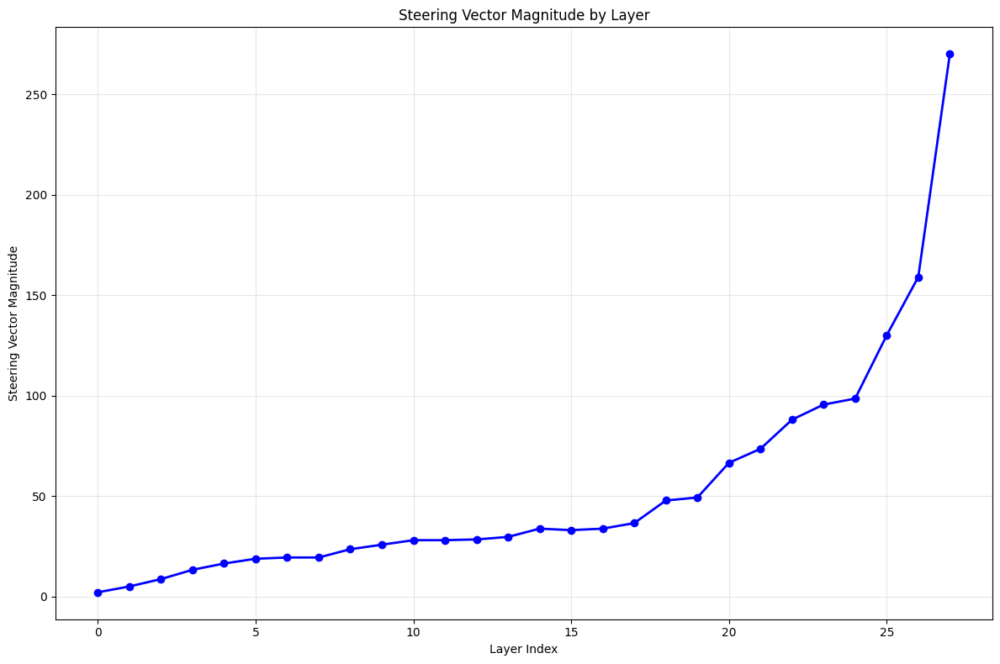

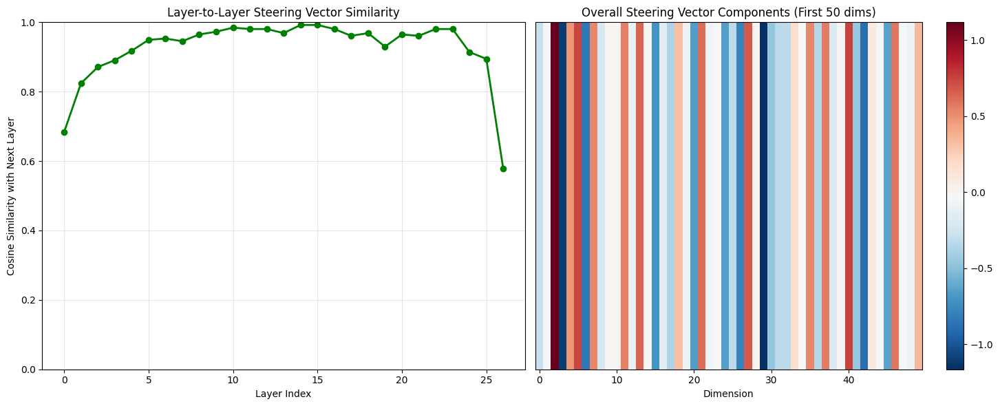

c:\Users\DarMan\stepik\Projekt_2Sem_DLS\Projekt\notebooks\..\visualize_computed_steering_vectors\visualisation_funktion.py:152: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axes = plt.subplots(2, 2, figsize=(16, 12))


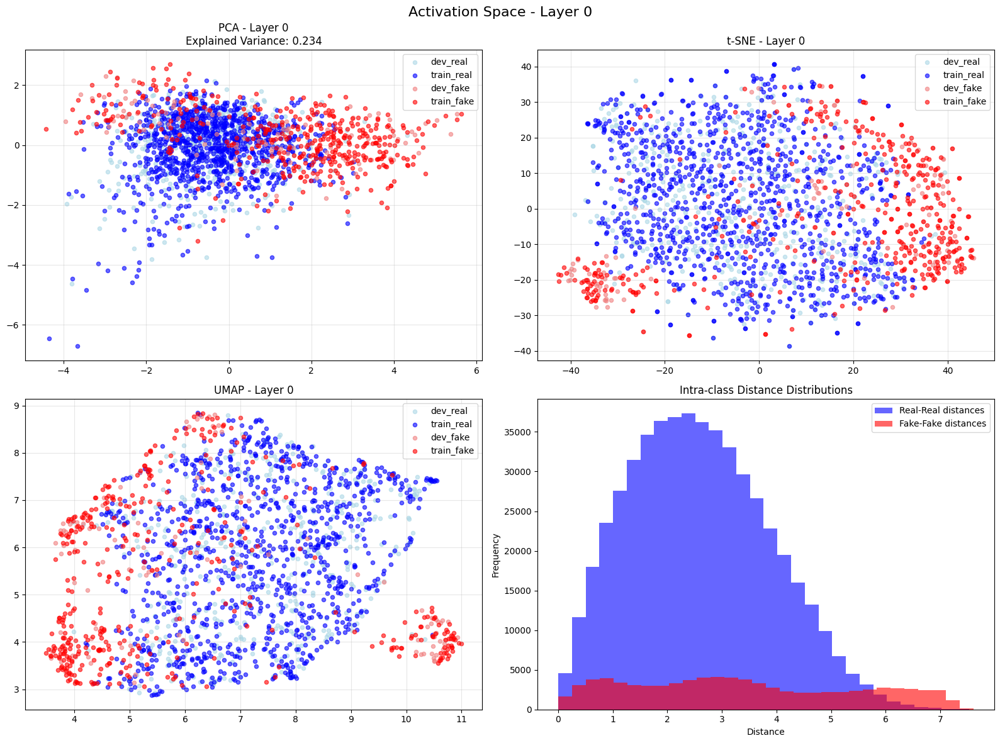

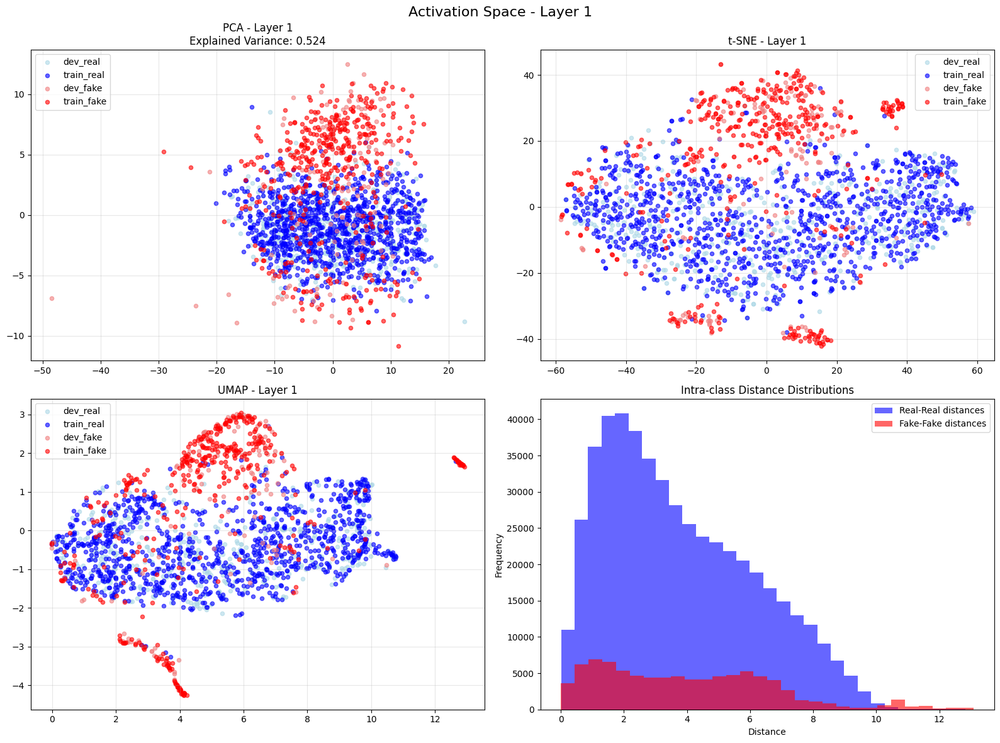

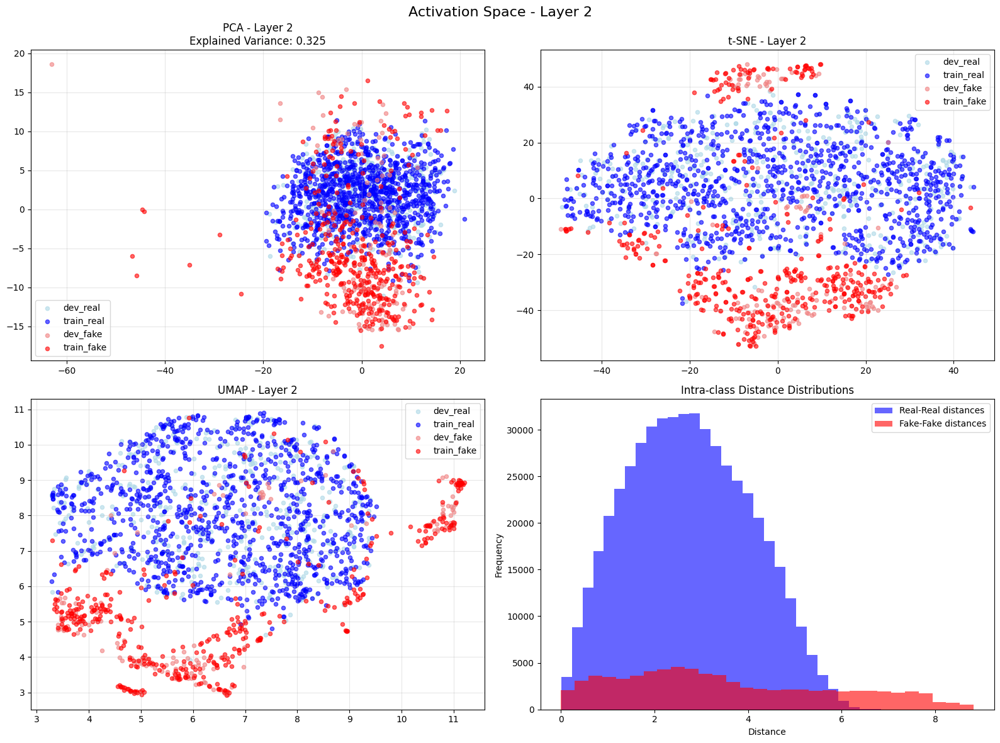

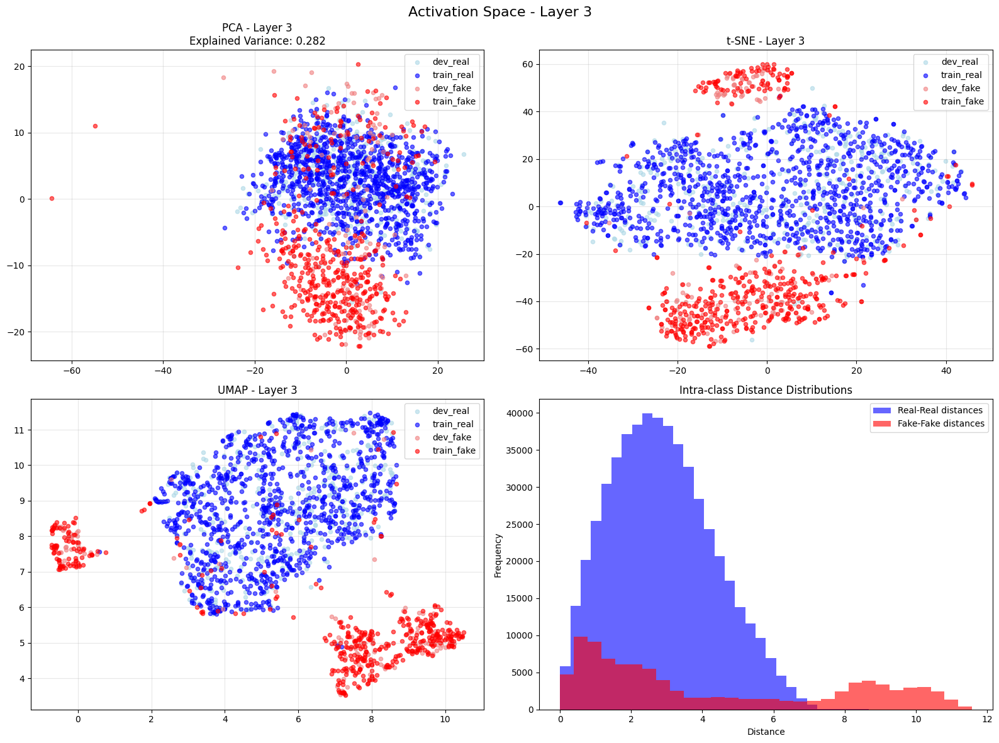

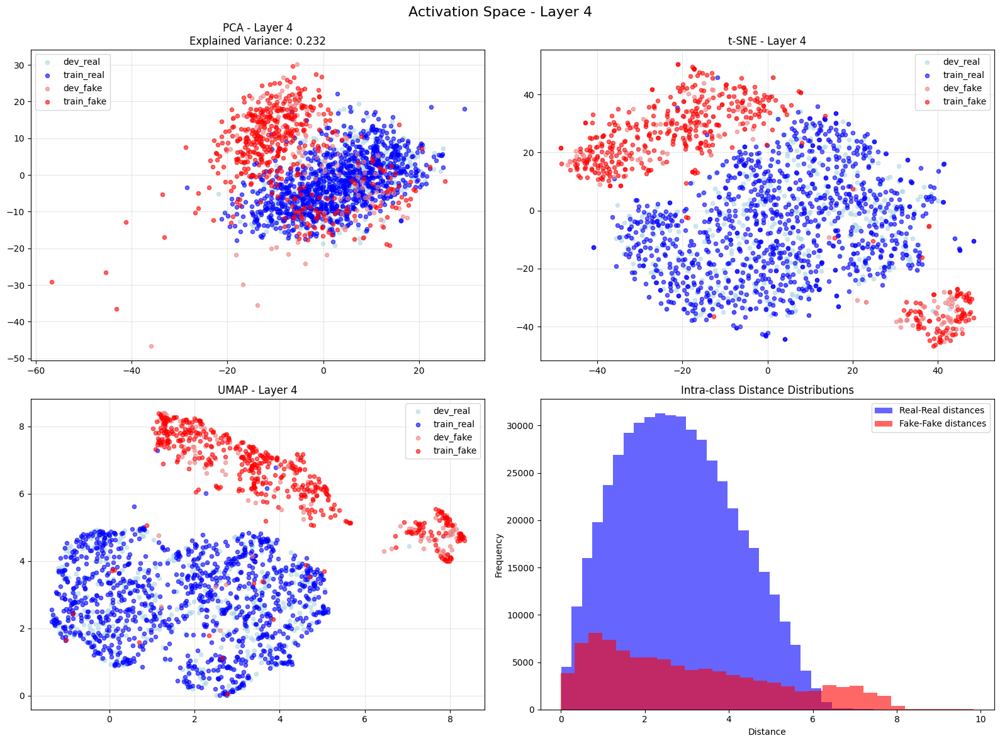

...

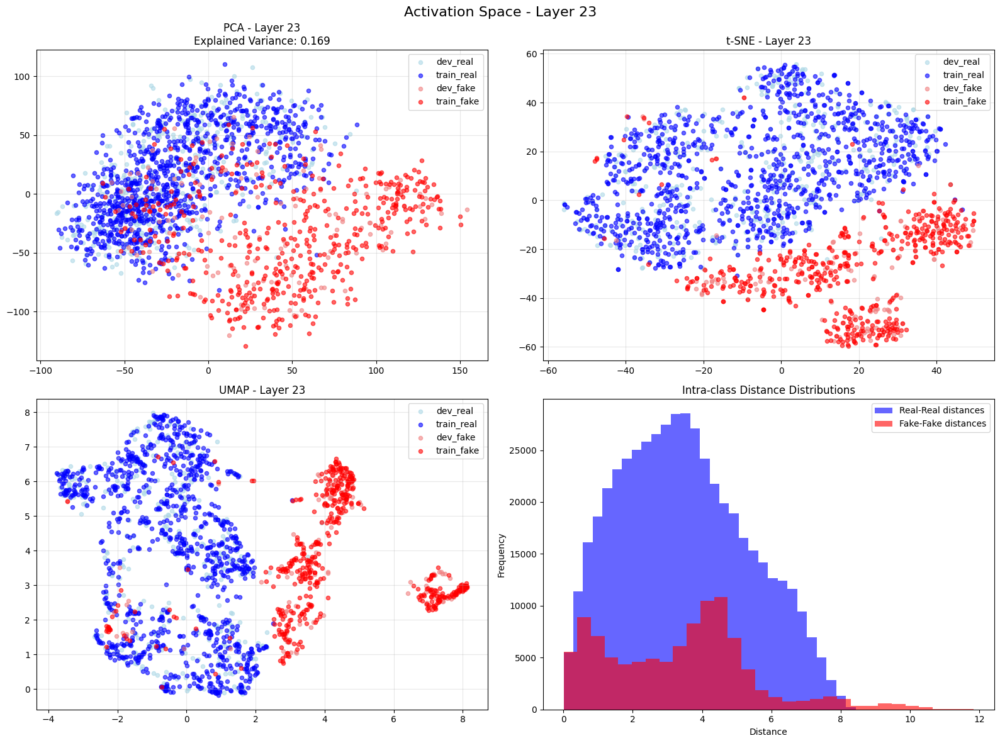

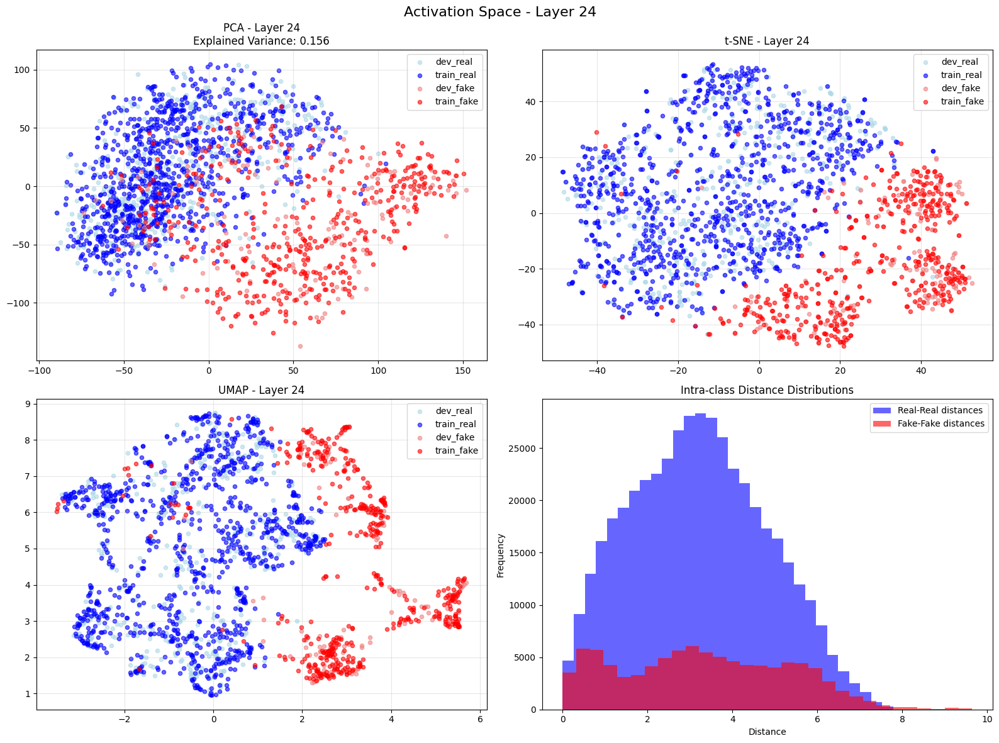

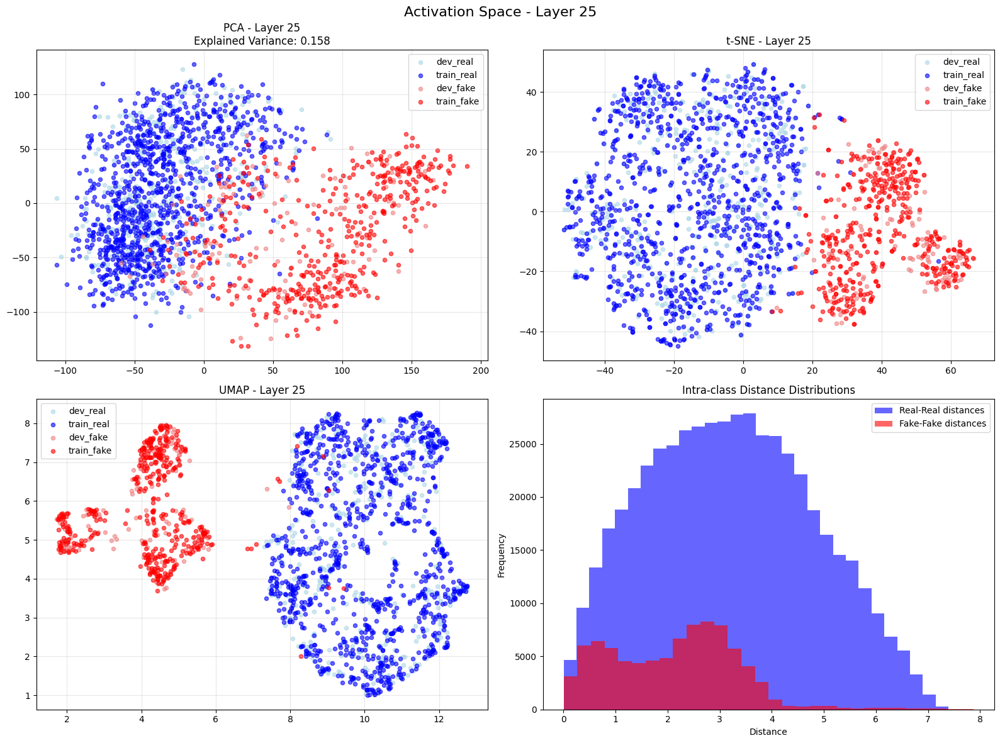

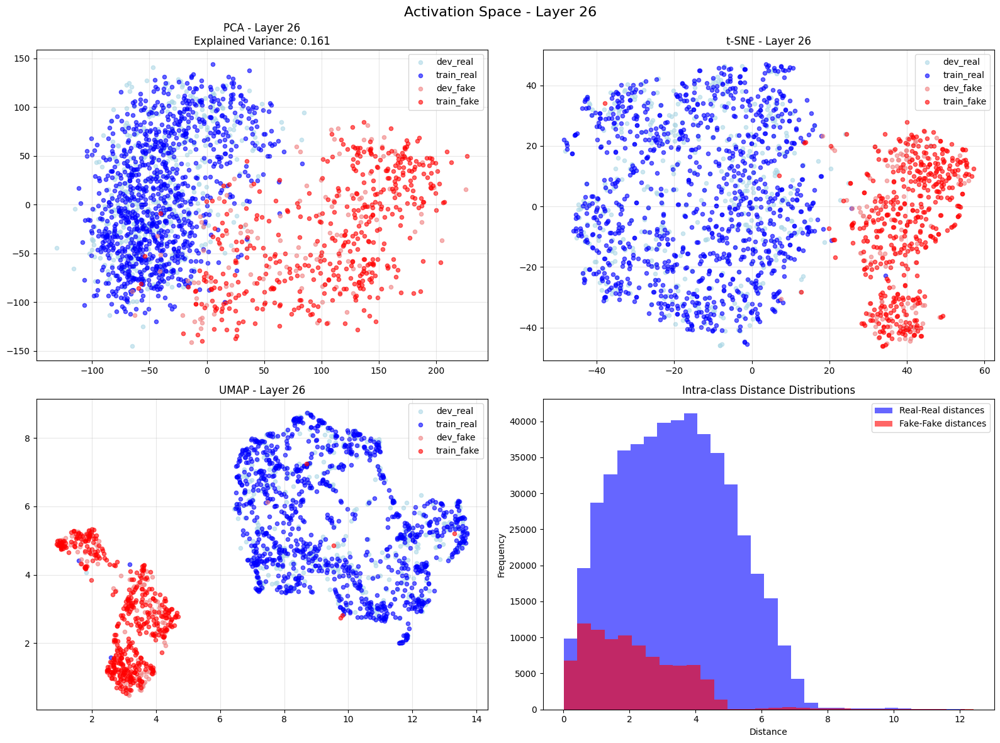

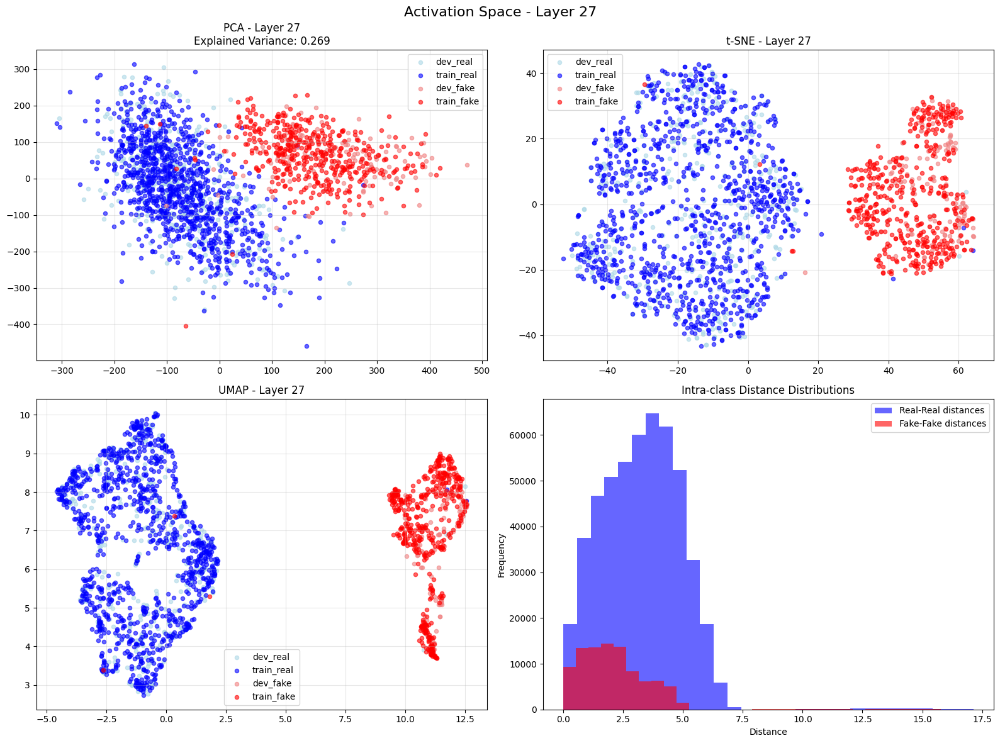

Computed activation space for all 28 layers
Creating combined visualization for 28 layers
Saved combined visualization for PCA to ../visualized_data_from_steering_vectors/steering_visualizations_falcon3\activation_space_all_layers_pca.png


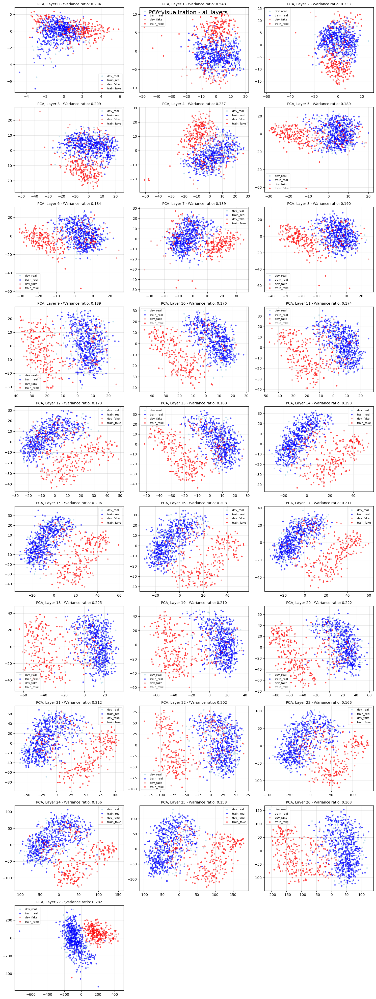

Saved combined visualization for t-SNE to ../visualized_data_from_steering_vectors/steering_visualizations_falcon3\activation_space_all_layers_t-sne.png


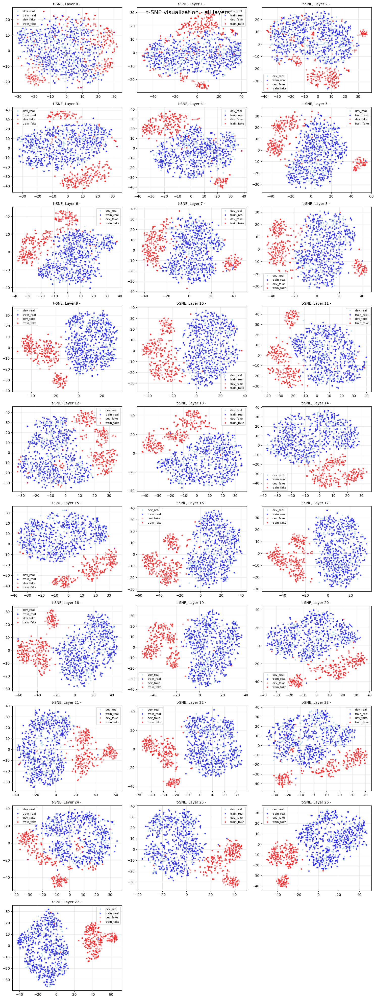

Saved combined visualization for UMAP to ../visualized_data_from_steering_vectors/steering_visualizations_falcon3\activation_space_all_layers_umap.png


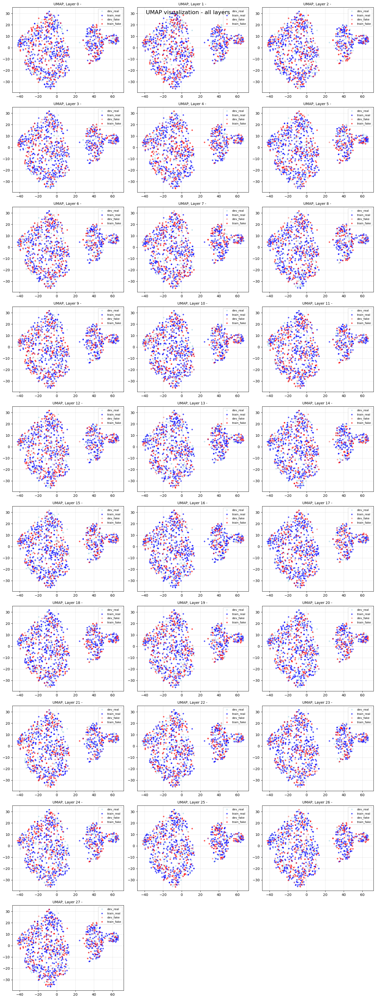

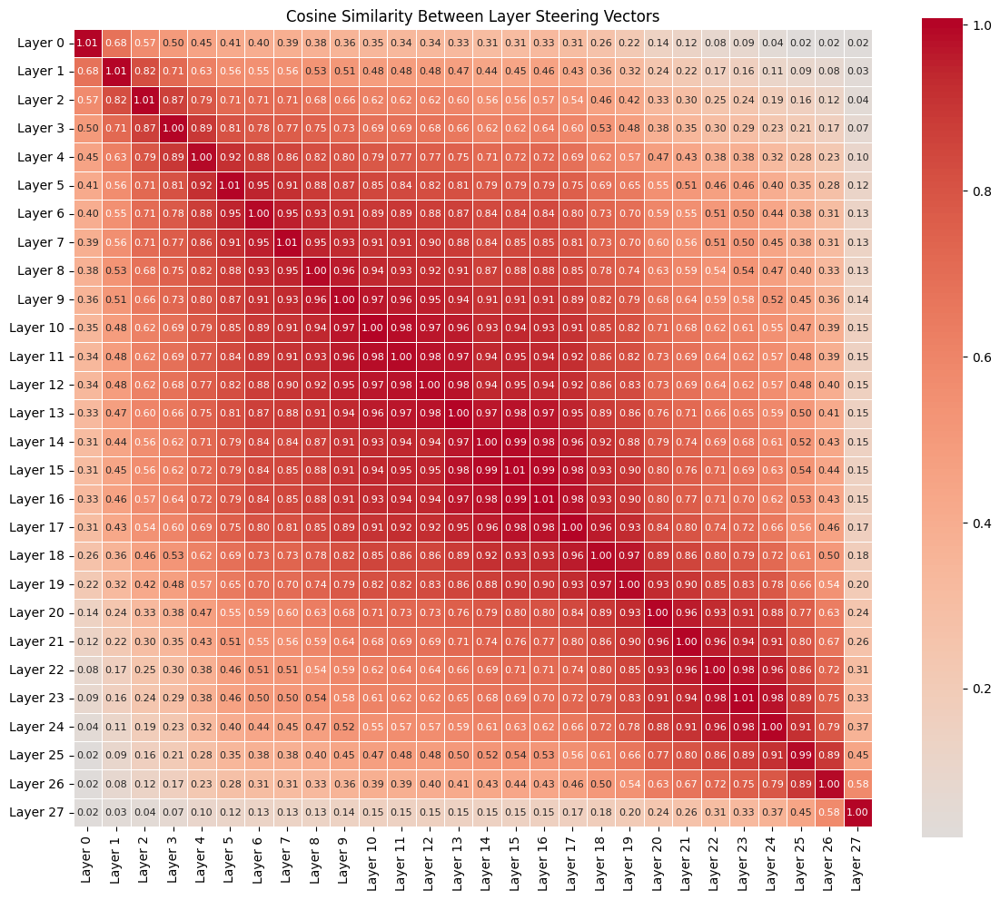

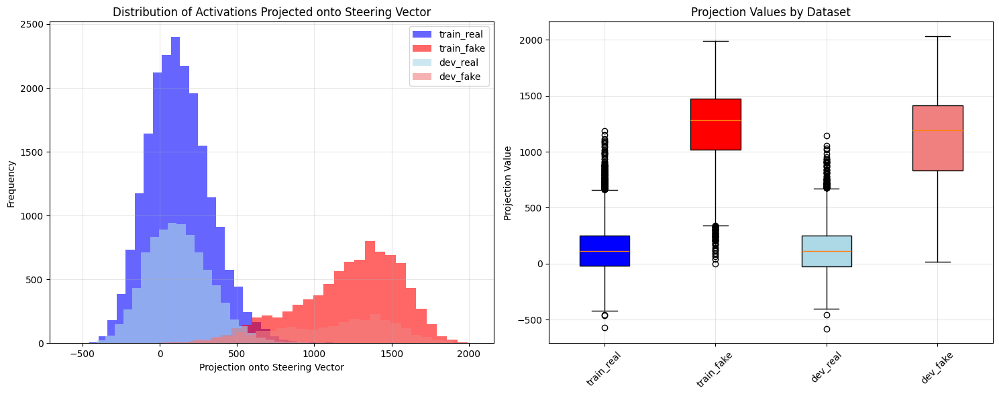


Projection Statistics:
train_real: Mean=125.7870, Std=205.6868
train_fake: Mean=1226.4861, Std=330.5671
dev_real: Mean=122.9640, Std=206.0730
dev_fake: Mean=1119.4271, Std=386.1544
Visualization completed! Plots saved to: ../visualized_data_from_steering_vectors/steering_visualizations_falcon3


In [3]:
visualize_steering_vectors(
        target_dtype=torch.float32,
        results_path="../computed_steering_data/falcon3_steering_vectors/complete_results.pkl",
        save_plots=True,
        plot_dir="../visualized_data_from_steering_vectors/steering_visualizations_falcon3")

In [ ]:
# import shutil
# shutil.make_archive('falcon3_steering_vectors', 'zip', 'falcon3_steering_vectors')

'c:\\Users\\DarMan\\stepik\\Projekt_2Sem_DLS\\Projekt\\falcon3_steering_vectors.zip'

## Выводы по первой части:
- Эта модель показывает какую-то смешунную картину из llama-2 и phi-2: на графике магнитуты видны скачки от 18 к 19 слою, от 20 к 21, от 25 к 26 и от 27 к 28. 
- Интересно, что график Layer-to-Layer Similarity показывает, как первые предпоследнии слои отличны по восприятию тестируемых концептов от других слоев, что нельзя было сказать о Phi-2. 
- Графики PCA, TSNE и UMAP показывают похожую картину как на экспериментах с llama: На первых слоях модели не удается хорощо поделить тексты. Но начиная с 5 слоя Falcon 3-7B-Base образуются класстеры (PCA и TSNE). 
- Overall Steering Vektor Components отличается от обоих предыдущих эеспериментов: здесь мы видим большое количество подавленных (синие полос) и нейтральных активаций и очень маленькое количество положительных. 
- Cosinus Similarity Correlation Matrix показывает, две сильные положительные корреляции: между слоями с 3 по 17 и между 20 по 27. Возможно, это обучловлено тем, что модель видела при обучении еще больше данных чем llama и тем самым стала более чувствительной к разным концептам, по крайней мере к концепту "фейковости". Это и подтверждают общее бенчматки между моделями, гду Falcon 3-7B-Base первосходит LLama-2. + у Falcon 3-7B-Base другой тип рамерности головы с использованием FlashAttention-3.

# Часть 2: Вычисление проекций и тренировка полученных результатов на трех классификаторах (логистической регрессии, random forest, SVM)

### Для этой части исследования я написала функции. Они получились довольно объемными, и для улучшения читаемости я вынесла их, также как и предыдущие функции, в отдельные файл "projection_and_ml_train_function.py" в папке "compute_projection".
    - load_steering_data: загружает раннее созданные данные
    - claculate_projections: вычисляет проекции
    - evaluate_all_layers: оценивает каждый классификатор по отдельности на всех слоях. Использует в себе функции create_classifikation_dataset(), calculate_correlation() и train_classifier().
    - plot_layer_performance(): рисует графики оценки обцчения по каждому слою и выводит топовые значения.

In [ ]:
sys.path.append('..') # Путь к папке с модулем compute_projection
from compute_projection import load_steering_data, calculate_projections, evaluate_all_layers, plot_layer_performance

Lade Trainingsdaten aus falcon3_steering_vectors
Lade Entwicklungsdaten aus falcon3_steering_vectors
TRAIN-DATA: 20353 real, 8421 fake Samples
DEV-DATA: 8663 real, 2643 fake Samples
Berechne Projektionen für Trainings- und Entwicklungsdaten...
Verarbeite 28 Layer-Steering-Vektoren
Trainingsprojektionen und Entwicklungsprojektionen gespeichert in falcon3_steering_vectors_dotProduct\projections
Evaluating all layers (train & dev)...
Combined results saved to falcon3_steering_vectors_dotProduct\layer_evaluation_results.csv
Best model: Logistic Regression (0.9821)


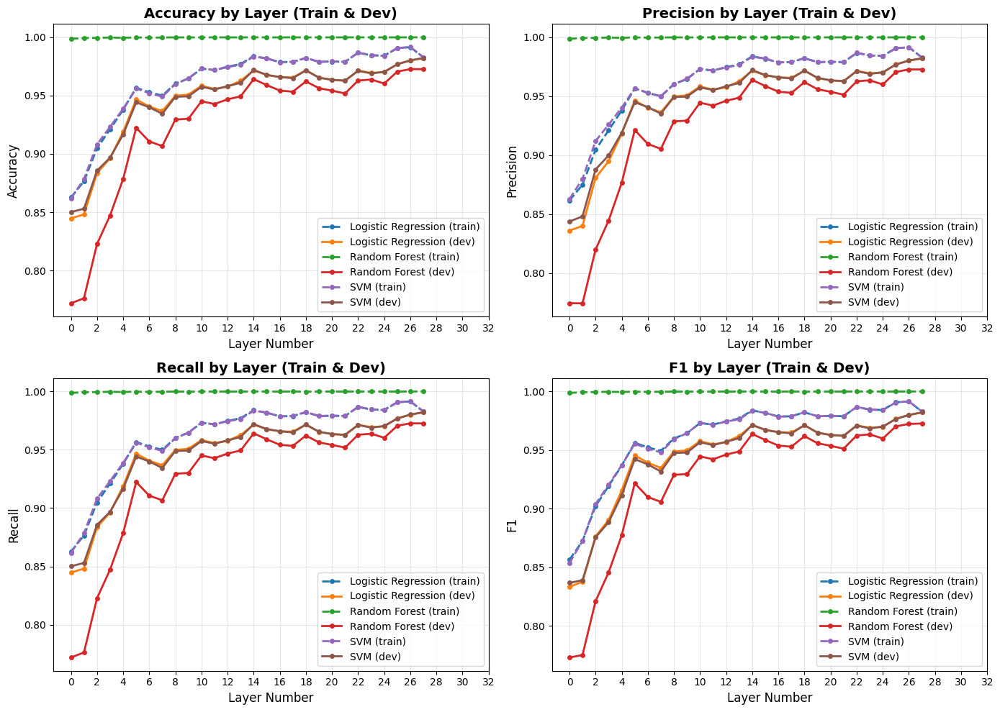

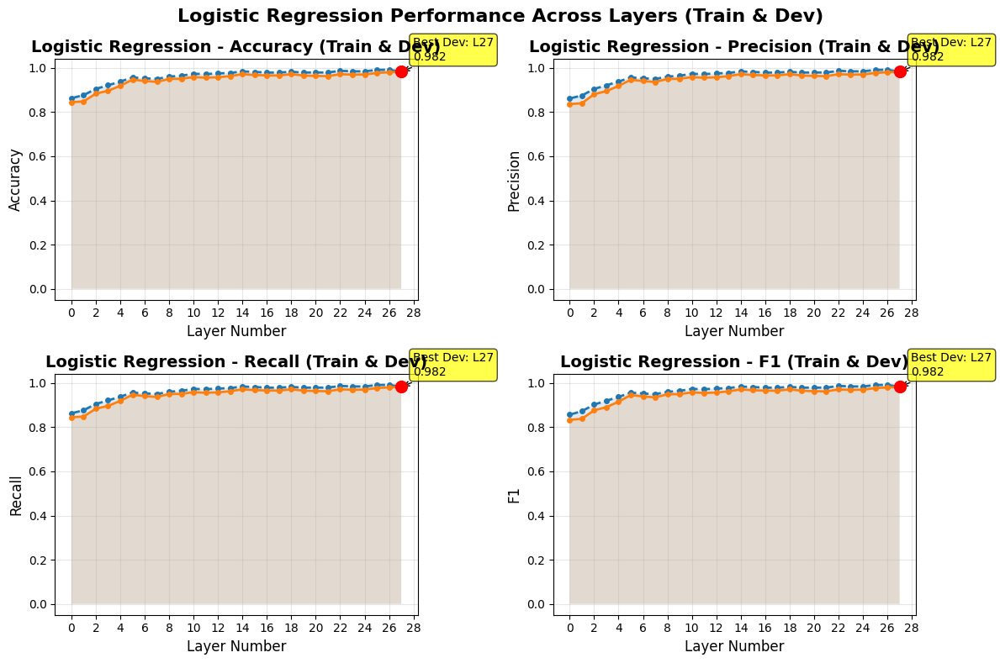

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

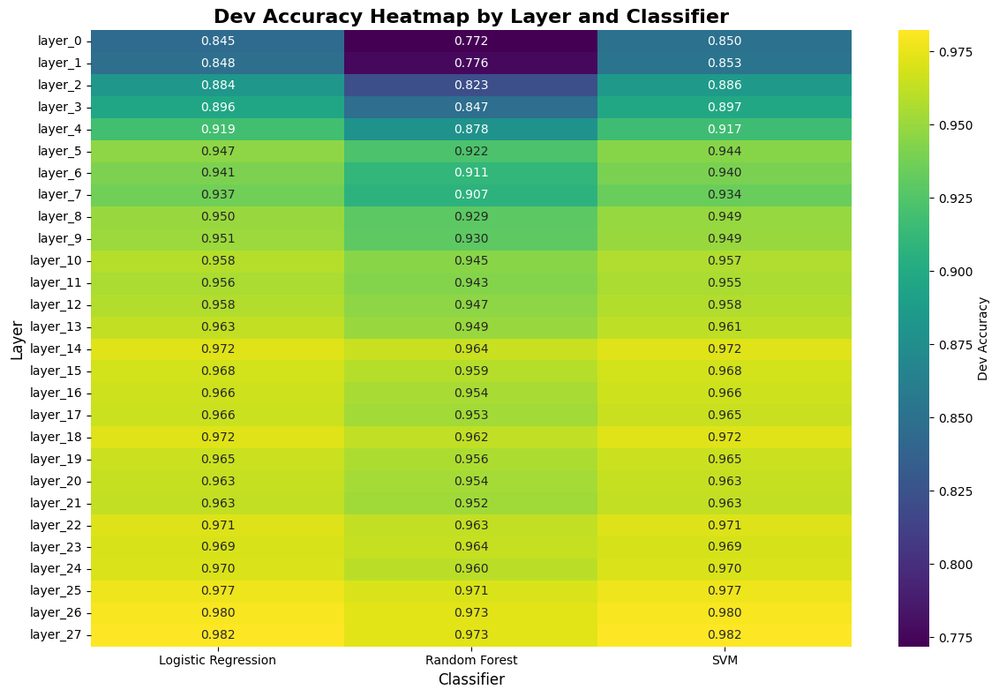

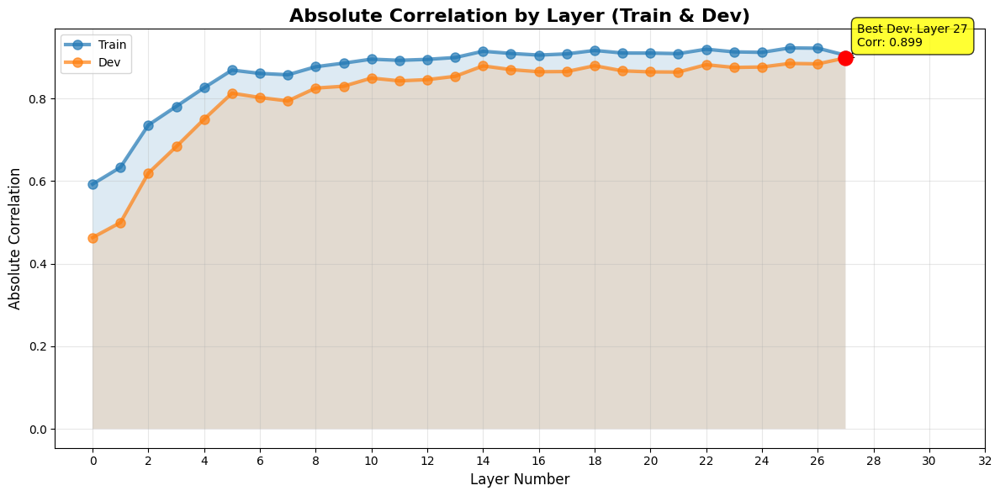

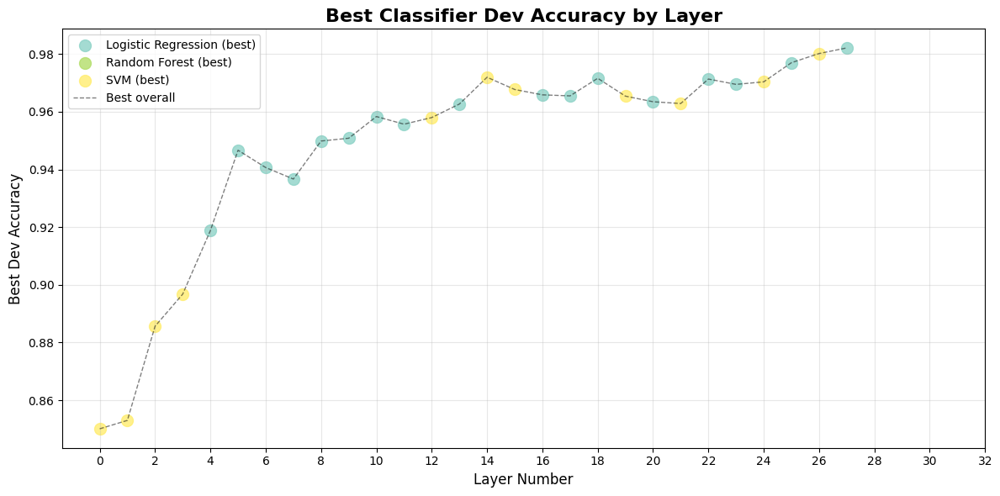

All plots saved to ./steering_vectors_dotProduct\plots

=== BEST LAYERS PER CLASSIFIER (Dev) ===
Logistic Regression: layer_27 (Dev Accuracy: 0.9821)
Random Forest: layer_26 (Dev Accuracy: 0.9727)
SVM: layer_27 (Dev Accuracy: 0.9821)

=== SUMMARY ===
'Total layers evaluated: 28'
'Total train samples: 28774'
'Total dev samples: 11306'
'\nBest dev correlation: layer_27 (r=0.8985)'
'Best dev F1 score: layer_27 with Logistic Regression (F1=0.9821)'

Top 5 layers by dev accuracy:
('   layer          classifier  dev_accuracy   dev_f1  dev_abs_correlation\n'
 'layer_27 Logistic Regression      0.982133 0.982103             0.898542\n'
 'layer_27                 SVM      0.982133 0.982100             0.898542\n'
 'layer_26                 SVM      0.980188 0.979989             0.884282\n'
 'layer_26 Logistic Regression      0.980011 0.979802             0.884282\n'
 'layer_25 Logistic Regression      0.977003 0.976736             0.885265')
'\nBest train F1 score: layer_14 with Random Forest (

In [ ]:
data_train, data_dev = load_steering_data(save_dir = "../computed_steering_data/falcon3_steering_vectors")

# Calculate projections
layer_projections_train, layer_projections_dev = calculate_projections(data_train, data_dev, save_dir="../computed_projection_data/falcon3_steering_vectors_dotProduct")

# Evaluate all layers
results_df, classifier_dfs, best_model_info = evaluate_all_layers(layer_projections_train, layer_projections_dev, save_dir="../computed_projection_data/falcon3_steering_vectors_dotProduct")

# Create visualizations
plot_layer_performance(results_df)

print("\n=== SUMMARY ===")
pprint(f"Total layers evaluated: {len(results_df['layer'].unique())}")

# Number of samples per set
train_samples = data_train['metadata']['train_real_count'] + data_train['metadata']['train_fake_count']
dev_samples = data_dev['metadata']['dev_real_count'] + data_dev['metadata']['dev_fake_count']
pprint(f"Total train samples: {train_samples}")
pprint(f"Total dev samples: {dev_samples}")

# Best Correlation (Dev)
best_corr_layer = results_df.loc[results_df['dev_abs_correlation'].idxmax()]
pprint(f"\nBest dev correlation: {best_corr_layer['layer']} (r={best_corr_layer['dev_correlation']:.4f})")

# Best layer according to Dev-F1
best_f1_layer = results_df.loc[results_df['dev_f1'].idxmax()]
pprint(f"Best dev F1 score: {best_f1_layer['layer']} with {best_f1_layer['classifier']} (F1={best_f1_layer['dev_f1']:.4f})")

# Top 5 Layers nach Dev-Accuracy
print("\nTop 5 layers by dev accuracy:")
top_5 = results_df.nlargest(5, 'dev_accuracy')[['layer', 'classifier', 'dev_accuracy', 'dev_f1', 'dev_abs_correlation']]
pprint(top_5.to_string(index=False))

# Optional: Best training values
best_train_f1_layer = results_df.loc[results_df['train_f1'].idxmax()]
pprint(f"\nBest train F1 score: {best_train_f1_layer['layer']} with {best_train_f1_layer['classifier']} (F1={best_train_f1_layer['train_f1']:.4f})")

## Выводы из второй части:
- на всех классификаторах мы видим скачкообразные графики. Более менее стабильное обучение можно заметить от слоя к слою на логистической регрессии, которая как и в предыдущих экспериментах дает лучший результат.
- Интересная картина видна на Heatmap, где на первых 5 слоях ситуация похожа на предыдущие модели - метрики линеарно растут. А после 5 слоя они стабильно держатся до самого последнего слоя. Возможно это обучловлено типом голов.
- По чувствительности к концепту "фейковости": чтобы достичь таких высоких результатов не обязательно обучаться на синтетических данных как phi-2, возможно достаточно другой архитектуры (чем у llama) и более разнообразных данных для обучения.


- все классификаторы растут от слоя к слою и не переобучаются. По сравнению с llama,  первый слой сильнее всего влияет на результат: улавливает тестируемый концепт и это используется последующими слоями. По heatmap каждого из классификаторов видно, что первый слой достигает >0.85 accuracy на тестовой выборке, что не могkи достичь некоторый среднии слои в llama.
- По топу 5 слоев по классификаторам ситауция похожа на llama.


1. BEST LAYERS PER CLASSIFIER (Dev):
    - Logistic Regression: layer_27 (Dev Accuracy: 0.9821)
    - Random Forest: layer_26 (Dev Accuracy: 0.9727)
     -SVM: layer_27 (Dev Accuracy: 0.9821)

2. Top 5 layers by dev accuracy:

    | layer |  classifier  | dev_accuracy |  dev_f1 |  dev_abs_correlation |
    |-------|--------------|--------------|---------|----------------------|
    | layer_27 | Logistic Regression | 0.982133 | 0.982103 | 0.898542|
    | layer_27 | SVM | 0.982133 | 0.982100 | 0.898542 |
    | layer_26 |                SVM | 0.980188 | 0.979989 | 0.884282|
    | layer_26 | Logistic Regression | 0.980011 | 0.979802 | 0.884282|
    | layer_25 | Logistic Regression | 0.977003 | 0.976736 | 0.885265|

    Best train F1 score: layer_14 with Random Forest (F1=1.0000)

In [67]:
#import shutil
#from google.colab import files
#shutil.make_archive('/content/steering_vectors_dotProduct', 'zip', '/content/steering_vectors_dotProduct')
shutil.make_archive('falcon3_steering_vectors_dotProduct', 'zip', 'falcon3_steering_vectors_dotProduct')
#files.download('/content/steering_vectors_dotProduct.zip')

'c:\\Users\\DarMan\\stepik\\Projekt_2Sem_DLS\\Projekt\\falcon3_steering_vectors_dotProduct.zip'

# Часть 3: Эксперимент-2: перенос домена на тексты медицинского и финансового характера, как  с предыдущей моделью.

In [68]:
models_of_interest = {"train": ["human", "gpt-35"],
                      "dev": ["human", "gpt-35"]}
sources_of_interest = {"train": ["finance"],
                       "dev": ["finance"]}

splits_finance = {"train": None, "dev": None}

for split in splits_finance:
    splits_finance[split] = dataset[split].filter(
        lambda sample: sample["model"] in models_of_interest[split] and sample["sub_source"] in sources_of_interest[split]
    )
    df = splits_finance[split].to_pandas()
    sampled_df = df.groupby("model").apply(lambda x: x.sample(n=len(x), random_state=42)).reset_index(drop=True)
    splits_finance[split] = datasets.Dataset.from_pandas(sampled_df)

C:\Users\DarMan\AppData\Local\Temp\ipykernel_19104\1629246293.py:13: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  sampled_df = df.groupby("model").apply(lambda x: x.sample(n=len(x), random_state=42)).reset_index(drop=True)
C:\Users\DarMan\AppData\Local\Temp\ipykernel_19104\1629246293.py:13: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  sampled_df = df.groupby("model").apply(lambda x: x.sample(n=len(x), random_state=

In [69]:
splits_finance

{'train': Dataset({
     features: ['id', 'source', 'sub_source', 'lang', 'model', 'label', 'text'],
     num_rows: 5768
 }),
 'dev': Dataset({
     features: ['id', 'source', 'sub_source', 'lang', 'model', 'label', 'text'],
     num_rows: 2414
 })}

### Финансовый датасет буду использовать как тестовое множество, тренинг будет проходить на домене reddit.

In [70]:
empty_train = Dataset.from_dict({k :[] for k in splits_finance['train'].features})
data_finance = {
    'train': empty_train,
    'dev': concatenate_datasets([splits_finance["train"], splits_finance["dev"]])
}
data_finance

{'train': Dataset({
     features: ['id', 'source', 'sub_source', 'lang', 'model', 'label', 'text'],
     num_rows: 0
 }),
 'dev': Dataset({
     features: ['id', 'source', 'sub_source', 'lang', 'model', 'label', 'text'],
     num_rows: 8182
 })}

In [ ]:
results = calculate_steering_vector(
        model=model,
        tokenizer=tokenizer,
        datasets=data_finance,
        save_dir="../computed_steering_data/falcon3_steering_vectors_finance",
        max_length=2048,
        real_label=0,  # Label für echte Texte
        fake_label=1,   # Label für falsche Texte
        only_dev = True,
        device=device
    )

print("Steering vector calculation for the domain finance completed!")
# Zusätzliche Analyse
print("\nDetailed results:")
for key, value in results['metadata'].items():
    print(f"{key}: {value}")

INFO:__main__:Starting steering vector calculation on cuda:0
INFO:__main__:Train data: 0 real, 0 fake texts
INFO:__main__:Dev data: 3692 real, 4490 fake texts


train: 0 real texts, 0 fake texts
dev: 3692 real texts, 4490 fake texts


Processing data splits:   0%|          | 0/2 [00:00<?, ?it/s]INFO:__main__:Processing train data...
INFO:__main__:Processing 0 real texts from train
Processing texts: 0it [00:00, ?it/s]
INFO:__main__:Saving activations to falcon3_steering_vectors_finance\train_real_activations.pkl
INFO:__main__:Processing 0 fake texts from train
Processing texts: 0it [00:00, ?it/s]
INFO:__main__:Saving activations to falcon3_steering_vectors_finance\train_fake_activations.pkl
INFO:__main__:Processing dev data...
INFO:__main__:Processing 3692 real texts from dev
Processing texts: 100%|██████████| 3692/3692 [03:06<00:00, 19.81it/s]
INFO:__main__:Saving activations to falcon3_steering_vectors_finance\dev_real_activations.pkl
INFO:__main__:Processing 4490 fake texts from dev
Processing texts: 100%|██████████| 4490/4490 [03:49<00:00, 19.52it/s]
INFO:__main__:Saving activations to falcon3_steering_vectors_finance\dev_fake_activations.pkl
Processing data splits: 100%|██████████| 2/2 [06:58<00:00, 209.29s/it]


Steering vector calculation for the domain finance completed!

Detailed results:
train_real_count: 0
train_fake_count: 0
dev_real_count: 3692
dev_fake_count: 4490
max_length: 2048
layer_type: decoder_block
device: cuda:0
real_label: 0
fake_label: 1


In [72]:
#shutil.make_archive('llama_steering_vectors_finance3', 'zip', 'llama_steering_vectors_finance3')
shutil.make_archive('falcon3_steering_vectors_finance', 'zip', 'falcon3_steering_vectors_finance')
#files.download('/content/steering_vectors_dotProduct.zip')

'c:\\Users\\DarMan\\stepik\\Projekt_2Sem_DLS\\Projekt\\falcon3_steering_vectors_finance.zip'

## Подготовка данных как это было проделано в первом эксперименте и создание визуализаций.

Lade Trainingsdaten aus falcon3_steering_vectors
Lade Entwicklungsdaten aus falcon3_steering_vectors_finance
TRAIN-DATA: 20353 real, 8421 fake Samples
DEV-DATA: 3692 real, 4490 fake Samples
Berechne Projektionen für Trainings- und Entwicklungsdaten...
Verarbeite 28 Layer-Steering-Vektoren
Trainingsprojektionen und Entwicklungsprojektionen gespeichert in falcon3_steeringVectors_dotProduct_fromFinance\projections
Evaluating all layers (train & dev)...
Combined results saved to falcon3_steeringVectors_dotProduct_fromFinance\layer_evaluation_results.csv
Best model: Logistic Regression (0.9919)


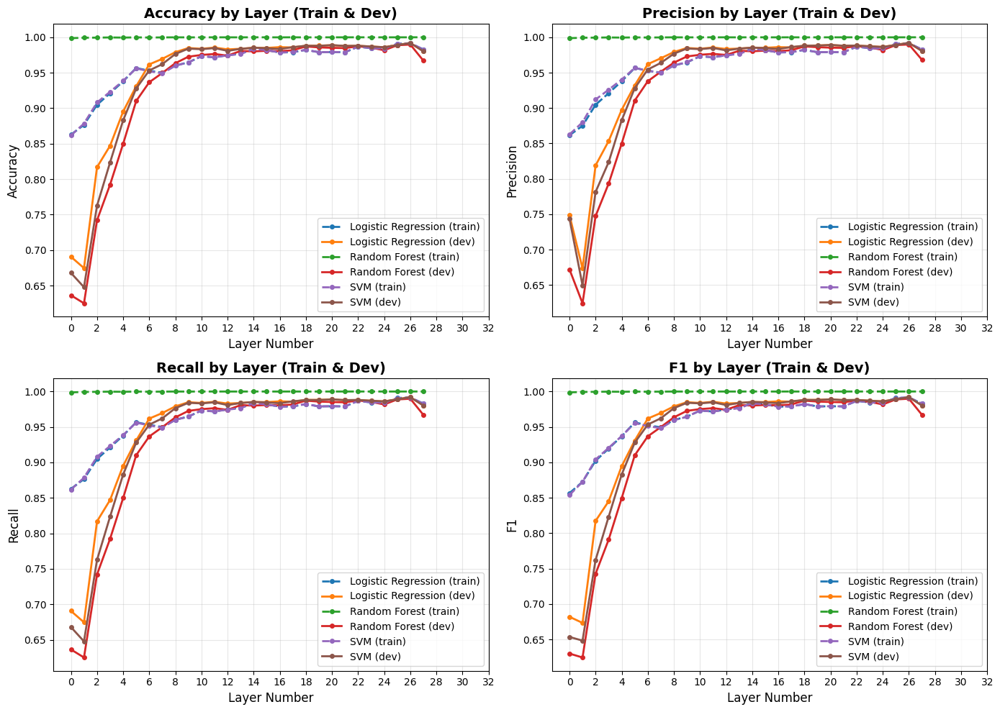

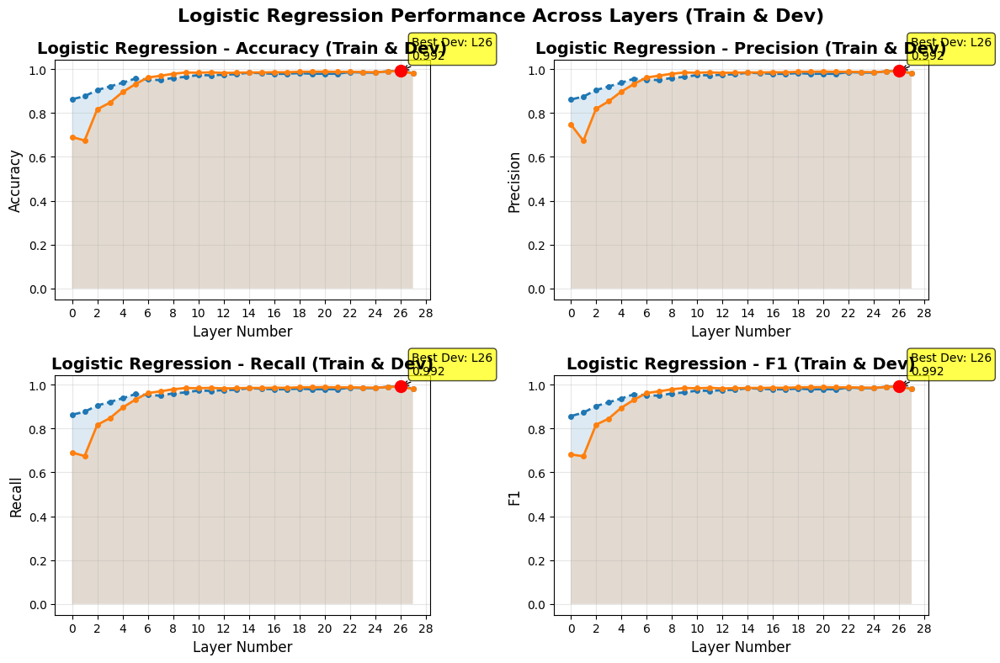

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

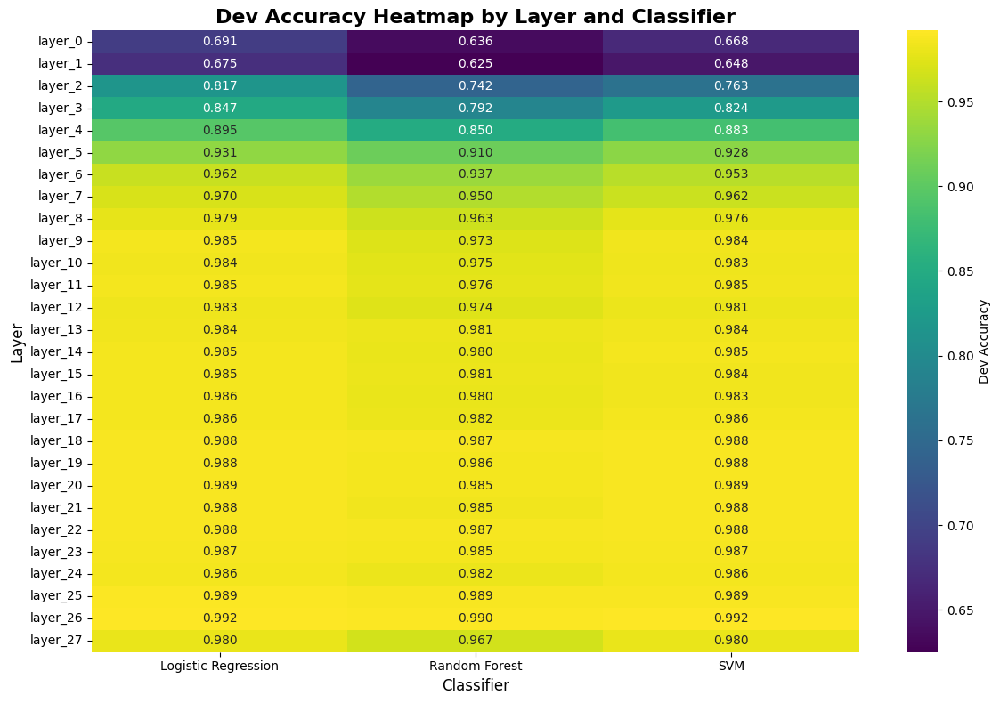

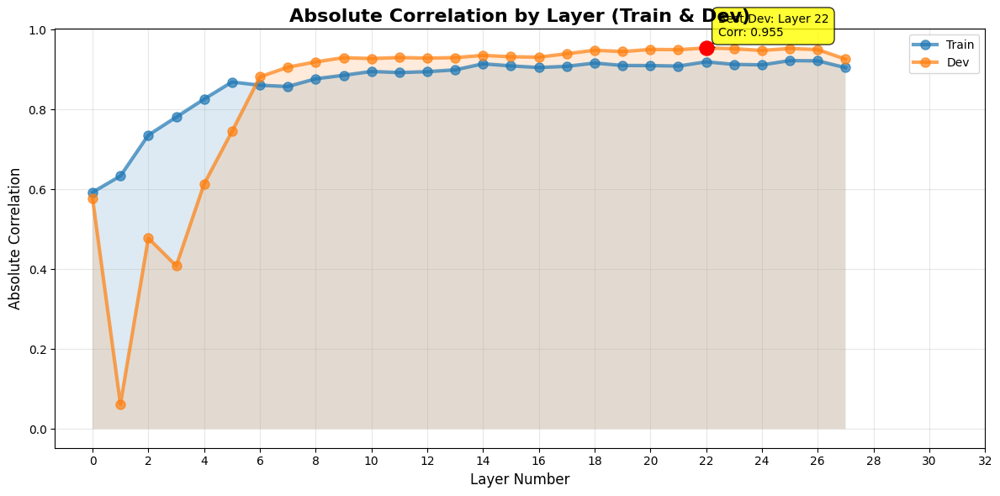

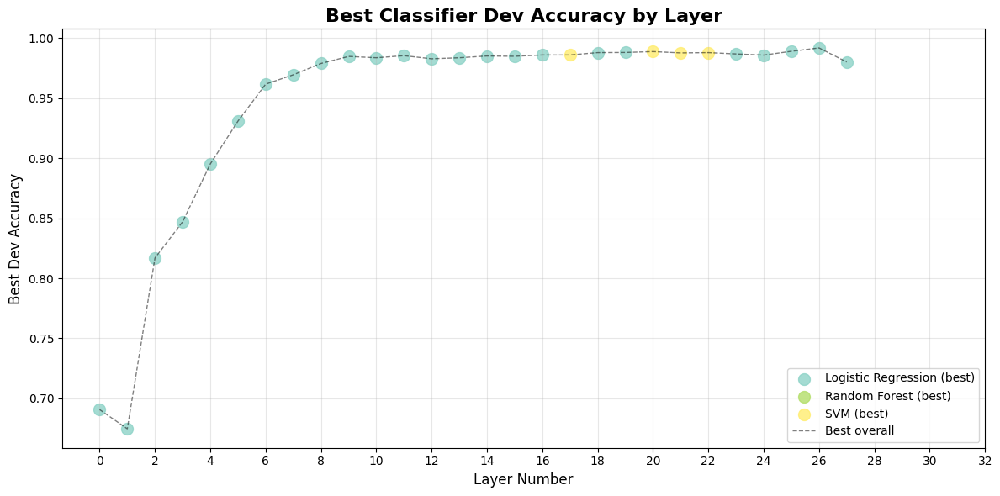

All plots saved to ./steering_vectors_dotProduct\plots

=== BEST LAYERS PER CLASSIFIER (Dev) ===
Logistic Regression: layer_26 (Dev Accuracy: 0.9919)
Random Forest: layer_26 (Dev Accuracy: 0.9897)
SVM: layer_26 (Dev Accuracy: 0.9919)

=== SUMMARY ===
'Total layers evaluated: 28'
'Total train samples: 28774'
'Total dev samples: 8182'
'\nBest dev correlation: layer_22 (r=0.9546)'
'Best dev F1 score: layer_26 with Logistic Regression (F1=0.9919)'

Top 5 layers by dev accuracy:
('   layer          classifier  dev_accuracy   dev_f1  dev_abs_correlation\n'
 'layer_26 Logistic Regression      0.991934 0.991938             0.950295\n'
 'layer_26                 SVM      0.991934 0.991938             0.950295\n'
 'layer_26       Random Forest      0.989734 0.989740             0.950295\n'
 'layer_25 Logistic Regression      0.989122 0.989132             0.953203\n'
 'layer_20                 SVM      0.988878 0.988888             0.950769')
'\nBest train F1 score: layer_14 with Random Forest (F

In [ ]:
data_train, data_dev_finance = load_steering_data(save_dir = "../computed_steering_data/falcon3_steering_vectors", domain_tag = "from_another_domain", alt_dir = "../computed_steering_data/falcon3_steering_vectors_finance")

# Calculate projections
layer_projections_train_finance, layer_projections_dev_finance  = calculate_projections(data_train, data_dev_finance, save_dir = "../computed_projection_data/falcon3_steeringVectors_dotProduct_fromFinance")

# Evaluate all layers
results_df, classifier_dfs, best_model_info = evaluate_all_layers(layer_projections_train_finance, layer_projections_dev_finance, save_dir = "../computed_projection_data/falcon3_steeringVectors_dotProduct_fromFinance")

# Create visualizations
plot_layer_performance(results_df)

# Print summary
print("\n=== SUMMARY ===")
pprint(f"Total layers evaluated: {len(results_df['layer'].unique())}")

# Number of samples per set
train_samples = data_train['metadata']['train_real_count'] + data_train['metadata']['train_fake_count']
dev_samples = data_dev_finance['metadata']['dev_real_count'] + data_dev_finance['metadata']['dev_fake_count']
pprint(f"Total train samples: {train_samples}")
pprint(f"Total dev samples: {dev_samples}")

#Best Correlation (Dev)
best_corr_layer = results_df.loc[results_df['dev_abs_correlation'].idxmax()]
pprint(f"\nBest dev correlation: {best_corr_layer['layer']} (r={best_corr_layer['dev_correlation']:.4f})")

# Best layer according to Dev-F1
best_f1_layer = results_df.loc[results_df['dev_f1'].idxmax()]
pprint(f"Best dev F1 score: {best_f1_layer['layer']} with {best_f1_layer['classifier']} (F1={best_f1_layer['dev_f1']:.4f})")

# Top 5 Layers nach Dev-Accuracy
print("\nTop 5 layers by dev accuracy:")
top_5 = results_df.nlargest(5, 'dev_accuracy')[['layer', 'classifier', 'dev_accuracy', 'dev_f1', 'dev_abs_correlation']]
pprint(top_5.to_string(index=False))

#Optional: Best training values
best_train_f1_layer = results_df.loc[results_df['train_f1'].idxmax()]
pprint(f"\nBest train F1 score: {best_train_f1_layer['layer']} with {best_train_f1_layer['classifier']} (F1={best_train_f1_layer['train_f1']:.4f})")

In [74]:
shutil.make_archive('microsoftPhi2_steeringVectors_dotProduct_fromFinance', 'zip', 'microsoftPhi2_steeringVectors_dotProduct_fromFinance')

'c:\\Users\\DarMan\\stepik\\Projekt_2Sem_DLS\\Projekt\\microsoftPhi2_steeringVectors_dotProduct_fromFinance.zip'

## Выводы из третий части (перенос на финансовый): 
- При переносе домена (from general to specific language) картина такая же как с llama и phi. Первые и второй слои сильно просидают как у llama. После этого обучение выравнивается и это даже происходит быстрее чем у llama.
- Как и у прерыдущих двух моделей подтверждение гипотезы о неоднородности копцепта "фейковости". 


1. BEST LAYERS PER CLASSIFIER (Dev):
    - Logistic Regression: layer_26 (Dev Accuracy: 0.9919)
    - Random Forest: layer_26 (Dev Accuracy: 0.9897)
    - SVM: layer_26 (Dev Accuracy: 0.9919)

2. Еop 5 layers by dev accuracy:

    | layer | classifier | dev_accuracy | dev_f1 | dev_abs_correlation|
    |-------|--------------|--------------|---------|----------------------|
    | layer_26 | Logistic Regression | 0.991934 | 0.991938 | 0.950295|
    | layer_26 |                SVM   | 0.991934 | 0.991938  | 0.950295|
    | layer_26 |      Random Forest   | 0.989734 | 0.989740  | 0.950295|
    | layer_25 | Logistic Regression   | 0.989122 | 0.989132  | 0.953203|
    | layer_20 |                SVM   | 0.988878 |0.988888  | 0.950769|

    Best train F1 score: layer_14 with Random Forest (F1=1.0000)

## Эксперимент на медицинских данных: т.к. их тоже немного, train и dev объединю и сделаю из них тестовое множество.

In [75]:
models_of_interest = {"train": ["human", "gpt-35"],
                      "dev": ["human", "gpt-35"]}
sources_of_interest = {"train": ["medicine"],
                       "dev": ["medicine"]}

splits_medicine = {"train": None, "dev": None}

for split in splits_medicine:
    splits_medicine[split] = dataset[split].filter(
        lambda sample: sample["model"] in models_of_interest[split] and sample["sub_source"] in sources_of_interest[split]
    )
    df = splits_medicine[split].to_pandas()
    sampled_df = df.groupby("model").apply(lambda x: x.sample(n=len(x), random_state=42)).reset_index(drop=True)
    splits_medicine[split] = datasets.Dataset.from_pandas(sampled_df)

C:\Users\DarMan\AppData\Local\Temp\ipykernel_19104\2066332619.py:13: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  sampled_df = df.groupby("model").apply(lambda x: x.sample(n=len(x), random_state=42)).reset_index(drop=True)
C:\Users\DarMan\AppData\Local\Temp\ipykernel_19104\2066332619.py:13: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  sampled_df = df.groupby("model").apply(lambda x: x.sample(n=len(x), random_state=

In [76]:
splits_medicine

{'train': Dataset({
     features: ['id', 'source', 'sub_source', 'lang', 'model', 'label', 'text'],
     num_rows: 1769
 }),
 'dev': Dataset({
     features: ['id', 'source', 'sub_source', 'lang', 'model', 'label', 'text'],
     num_rows: 732
 })}

In [78]:
empty_train = Dataset.from_dict({k :[] for k in splits_medicine['train'].features})
data_medicine = {
    'train': empty_train,
    'dev': concatenate_datasets([splits_medicine["train"], splits_medicine["dev"]])
}
data_medicine

{'train': Dataset({
     features: ['id', 'source', 'sub_source', 'lang', 'model', 'label', 'text'],
     num_rows: 0
 }),
 'dev': Dataset({
     features: ['id', 'source', 'sub_source', 'lang', 'model', 'label', 'text'],
     num_rows: 2501
 })}

In [ ]:
results = calculate_steering_vector(
        model=model,
        tokenizer=tokenizer,
        datasets=data_medicine,
        save_dir="../computed_steering_data/falcon3_steering_vectors_medicine",
        max_length=2048,
        real_label=0,  # Label für echte Texte
        fake_label=1,   # Label für falsche Texte
        only_dev = True,
        device=device
    )

print("Steering vector calculation for the domain finance completed!")
# Zusätzliche Analyse
print("\nDetailed results:")
for key, value in results['metadata'].items():
    print(f"{key}: {value}")

INFO:__main__:Starting steering vector calculation on cuda:0
INFO:__main__:Train data: 0 real, 0 fake texts
INFO:__main__:Dev data: 1238 real, 1263 fake texts


train: 0 real texts, 0 fake texts
dev: 1238 real texts, 1263 fake texts


Processing data splits:   0%|          | 0/2 [00:00<?, ?it/s]INFO:__main__:Processing train data...
INFO:__main__:Processing 0 real texts from train
Processing texts: 0it [00:00, ?it/s]
INFO:__main__:Saving activations to falcon3_steering_vectors_medicine\train_real_activations.pkl
INFO:__main__:Processing 0 fake texts from train
Processing texts: 0it [00:00, ?it/s]
INFO:__main__:Saving activations to falcon3_steering_vectors_medicine\train_fake_activations.pkl
INFO:__main__:Processing dev data...
INFO:__main__:Processing 1238 real texts from dev
Processing texts: 100%|██████████| 1238/1238 [00:47<00:00, 26.00it/s]
INFO:__main__:Saving activations to falcon3_steering_vectors_medicine\dev_real_activations.pkl
INFO:__main__:Processing 1263 fake texts from dev
Processing texts: 100%|██████████| 1263/1263 [01:03<00:00, 20.02it/s]
INFO:__main__:Saving activations to falcon3_steering_vectors_medicine\dev_fake_activations.pkl
Processing data splits: 100%|██████████| 2/2 [01:51<00:00, 55.79s/i

Steering vector calculation for the domain finance completed!

Detailed results:
train_real_count: 0
train_fake_count: 0
dev_real_count: 1238
dev_fake_count: 1263
max_length: 2048
layer_type: decoder_block
device: cuda:0
real_label: 0
fake_label: 1


In [80]:
shutil.make_archive('falcon3_steering_vectors_medicine', 'zip', 'falcon3_steering_vectors_medicine')

'c:\\Users\\DarMan\\stepik\\Projekt_2Sem_DLS\\Projekt\\falcon3_steering_vectors_medicine.zip'

Lade Trainingsdaten aus falcon3_steering_vectors
Lade Entwicklungsdaten aus falcon3_steering_vectors_medicine
TRAIN-DATA: 20353 real, 8421 fake Samples
DEV-DATA: 1238 real, 1263 fake Samples
Berechne Projektionen für Trainings- und Entwicklungsdaten...
Verarbeite 28 Layer-Steering-Vektoren
Trainingsprojektionen und Entwicklungsprojektionen gespeichert in falcon3_steeringVectors_dotProduct_fromMedicine\projections
Evaluating all layers (train & dev)...
Combined results saved to falcon3_steeringVectors_dotProduct_fromMedicine\layer_evaluation_results.csv
Best model: Logistic Regression (0.9919)


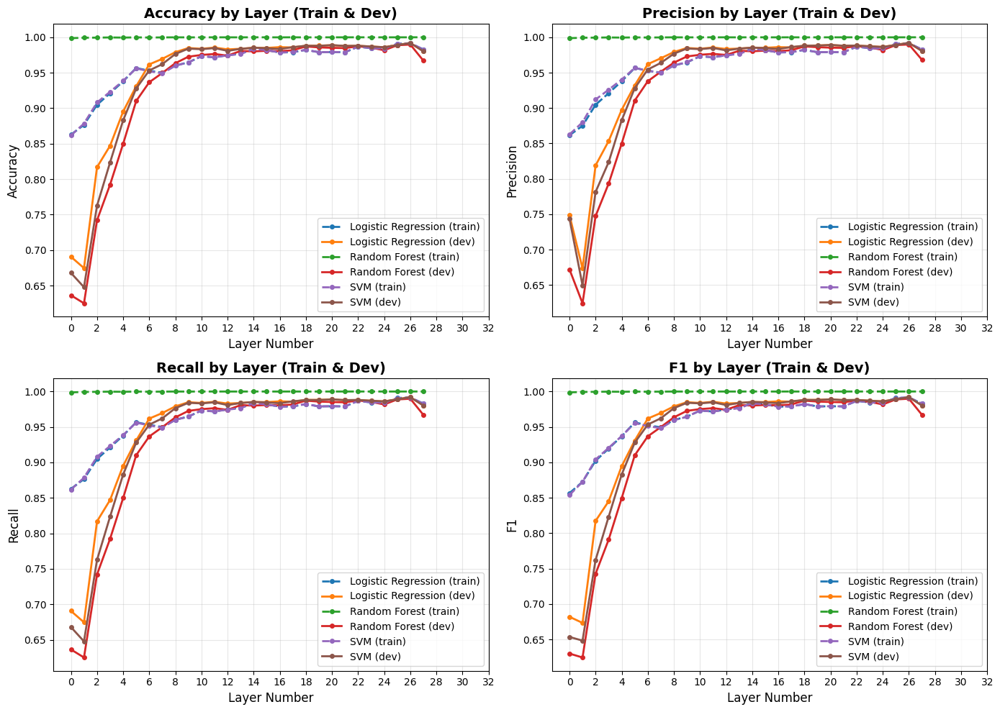

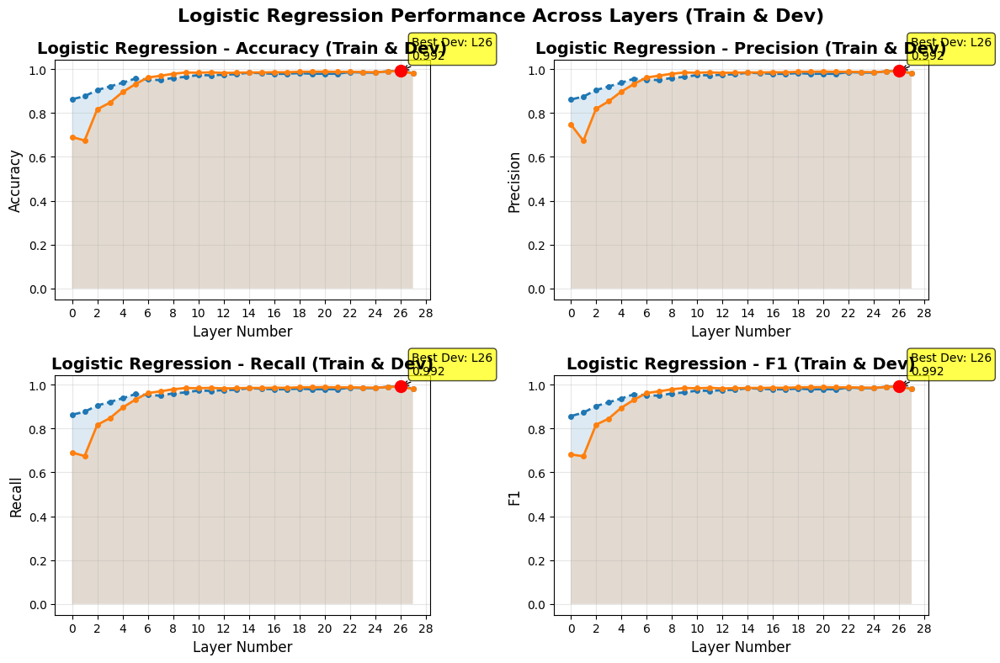

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

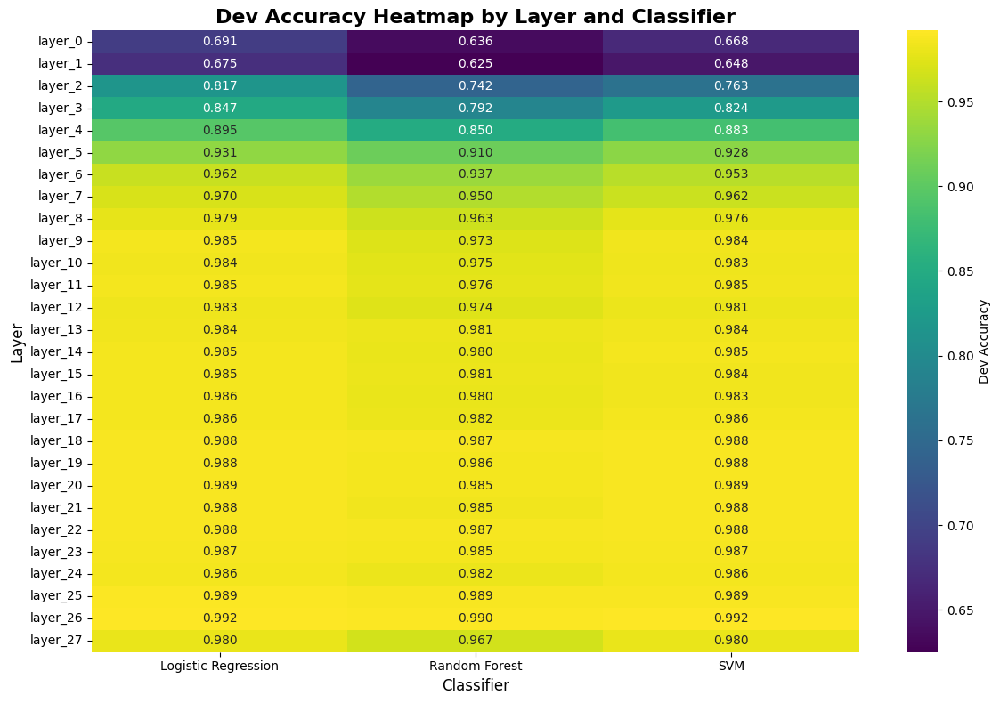

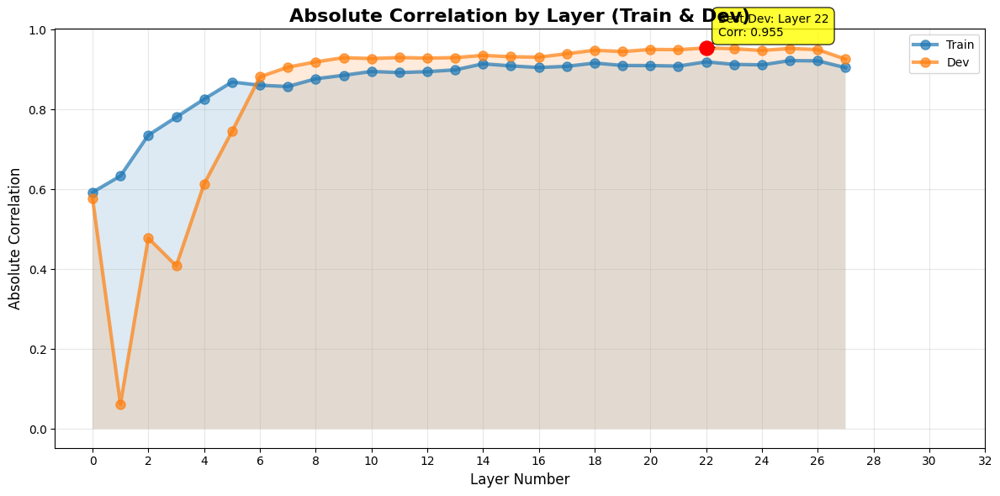

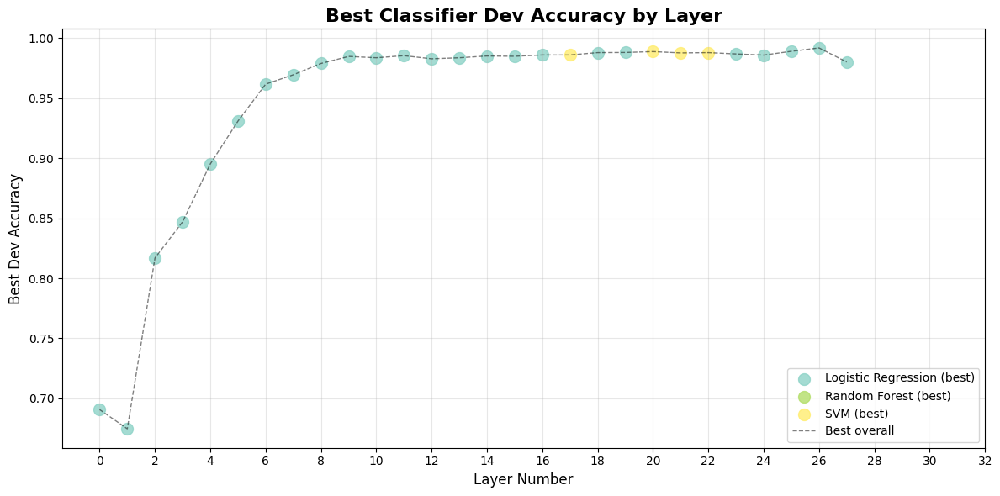

All plots saved to ./steering_vectors_dotProduct\plots

=== BEST LAYERS PER CLASSIFIER (Dev) ===
Logistic Regression: layer_26 (Dev Accuracy: 0.9919)
Random Forest: layer_26 (Dev Accuracy: 0.9897)
SVM: layer_26 (Dev Accuracy: 0.9919)

=== SUMMARY ===
'Total layers evaluated: 28'
'Total train samples: 28774'
'Total dev samples: 2501'
'\nBest dev correlation: layer_22 (r=0.9546)'
'Best dev F1 score: layer_26 with Logistic Regression (F1=0.9919)'

Top 5 layers by dev accuracy:
('   layer          classifier  dev_accuracy   dev_f1  dev_abs_correlation\n'
 'layer_26 Logistic Regression      0.991934 0.991938             0.950295\n'
 'layer_26                 SVM      0.991934 0.991938             0.950295\n'
 'layer_26       Random Forest      0.989734 0.989740             0.950295\n'
 'layer_25 Logistic Regression      0.989122 0.989132             0.953203\n'
 'layer_20                 SVM      0.988878 0.988888             0.950769')
'\nBest train F1 score: layer_14 with Random Forest (F

In [ ]:
data_train, data_dev_medicine = load_steering_data(save_dir = "../computed_steering_data/falcon3_steering_vectors", domain_tag = "from_another_domain", alt_dir = "../computed_steering_data/falcon3_steering_vectors_medicine")

# Calculate projections
layer_projections_train_medicine, layer_projections_dev_medicine  = calculate_projections(data_train, data_dev_finance, save_dir = "../computed_projection_data/falcon3_steeringVectors_dotProduct_fromMedicine")

# Evaluate all layers
results_df, classifier_dfs, best_model_info = evaluate_all_layers(layer_projections_train_medicine, layer_projections_dev_medicine, save_dir = "../computed_projection_data/falcon3_steeringVectors_dotProduct_fromMedicine")

# Create visualizations
plot_layer_performance(results_df)

# Print summary
print("\n=== SUMMARY ===")
pprint(f"Total layers evaluated: {len(results_df['layer'].unique())}")

# Number of samples per set
train_samples = data_train['metadata']['train_real_count'] + data_train['metadata']['train_fake_count']
dev_samples = data_dev_medicine['metadata']['dev_real_count'] + data_dev_medicine['metadata']['dev_fake_count']
pprint(f"Total train samples: {train_samples}")
pprint(f"Total dev samples: {dev_samples}")

# Best Correlation (Dev)
best_corr_layer = results_df.loc[results_df['dev_abs_correlation'].idxmax()]
pprint(f"\nBest dev correlation: {best_corr_layer['layer']} (r={best_corr_layer['dev_correlation']:.4f})")

#Best layer according to Dev-F1
best_f1_layer = results_df.loc[results_df['dev_f1'].idxmax()]
pprint(f"Best dev F1 score: {best_f1_layer['layer']} with {best_f1_layer['classifier']} (F1={best_f1_layer['dev_f1']:.4f})")

# Top 5 Layers оn Dev-Accuracy
print("\nTop 5 layers by dev accuracy:")
top_5 = results_df.nlargest(5, 'dev_accuracy')[['layer', 'classifier', 'dev_accuracy', 'dev_f1', 'dev_abs_correlation']]
pprint(top_5.to_string(index=False))

# Optional: Best training values
best_train_f1_layer = results_df.loc[results_df['train_f1'].idxmax()]
pprint(f"\nBest train F1 score: {best_train_f1_layer['layer']} with {best_train_f1_layer['classifier']} (F1={best_train_f1_layer['train_f1']:.4f})")

In [82]:
shutil.make_archive('falcon3_steeringVectors_dotProduct_fromMedicine', 'zip', 'falcon3_steeringVectors_dotProduct_fromMedicine')

'c:\\Users\\DarMan\\stepik\\Projekt_2Sem_DLS\\Projekt\\falcon3_steeringVectors_dotProduct_fromMedicine.zip'

## Выводы из третий части (перенос на медицинский домен): 
- Ситуация аналогична эксперименту с финансовыми данными: Метрики остались такими же и графики никак не поменялись.

# Основной вывод из первой части с моделью llama-2-7b:
Эксперимент с Falcon 3-7B-Base выявил, что модель сочетает черты как llama-2, так и phi-2, но при этом демонстрирует собственную специфику в обработке концепта "фейковости". На графиках магнитуды заметны несколько выраженных скачков между определёнными слоями (18–19, 20–21, 25–26, 27–28), что говорит о поэтапном появлении новой информации о концепте на разных уровнях. Layer-to-Layer Similarity показывает, что первые и предпоследние слои существенно отличаются по восприятию концепта, что отличает Falcon от phi-2.

Методы визуализации (PCA, t-SNE, UMAP) подтверждают: чёткая кластеризация текстов появляется только после 5-го слоя, а структура steering-векторов Falcon отличается преобладанием подавленных и нейтральных активаций при минимуме положительных. Корреляционный анализ выявил две зоны сильной положительной корреляции между слоями (3–17 и 20–27), что, вероятно, связано с особенностями архитектуры Falcon и большим разнообразием обучающих данных.

По работе классификаторов: все модели демонстрируют рост метрик по слоям без переобучения, а логистическая регрессия снова показывает наилучшую стабильность. После 5-го слоя метрики стабильно высоки до конца сети. Для достижения высокой чувствительности к "фейковости" Falcon не требует синтетических данных, как phi-2, — архитектура и разнообразие данных оказывают ключевое влияние.

При переносе на финансовый и медицинский домены поведение модели аналогично llama и phi-2: первые слои теряют значимость, но обучение быстро стабилизируется, а гипотеза о неоднородности концепта "фейковости" подтверждается. Лучшие метрики достигаются на последних слоях (25–27), а показатели точности и F1 остаются высокими и стабильными.

В целом, Falcon 3-7B-Base демонстрирует гибкое и многоступенчатое формирование концепта "фейковости", высокую устойчивость к смене домена и превосходит llama-2 по ряду бенчмарков, что связано с особенностями архитектуры и масштабом обучающих данных